# TDL 7.1 Thinking with Deep Learning: Week 7 Part 1
# Reinforcement Learning

__Instructor:__ James Evans

__Teaching Assistants & Content Creators/Organisers:__ Bhargav Srinivasa Desikan (Notebook Author), James Evans (Notebook Editor), Likun Cao (Notebook Reviewer)

In this notebook we will begin to explore reinforcement learning. Let's start with using this [cheatsheet of RL terms](https://colab.research.google.com/drive/1eN33dPVtdPViiS1njTW_-r-IYCDTFU7N#scrollTo=NXMgDjEcZ47S) from this [PyTorch tutorial](https://pytorch.org/tutorials/intermediate/mario_rl_tutorial.html) to ground ourselves. Another powerful introduction, though it is a focus on Deep Reinforcement Learning: [OpenAI Spinning Up](https://spinningup.openai.com/en/latest/spinningup/rl_intro.html).

A large part of this notebook will be using the workshops and tutorials from the O'Reilly book on Reinforcement Learning: https://rl-book.com/learn/

# RL Cheatsheet



## Basic Concept


![pic](https://drive.google.com/uc?id=1S7fdgKYw-1R1zwyUVOAC6qdlFA9_an2M)



### Action
$$
a \in {\rm I\!R}^{d_a}
$$
Under the RL framework, action is the only thing that the agent has control over. The agent can choose to act randomly, disregarding the environment reward and state, or to act greedily and maximize the reward from next step. Action is how the agent responds to the environment. 
Action could be a real value or a vector. The set of all actions the agent can make are called *action space*. 

### State
$$
s \in {\rm I\!R}^{d_s}
$$
State is what completely characterizes the current environment. It lies entirely out of control of the agent. 
Like action, state could be a real value or a vector. The set of all possible states the environment can be in are called *state space*. 



### Reward
$$
r \in {\rm I\!R}
$$
Reward is the key feedback from environment to agent. It is what drives the agent to learn and to change its future action. Think about reward as training data in a supervised learning framework. 
Unlike action and state, reward is always a single value. 


## Basic Relationship

$$
a_t \sim \pi(s_t)
$$

What does the agent's action depend on? The agent acts based on its observation from the environment, which is the state. Reward changes how the agent acts in future, but does not affect how the agent makes current action. 

The function $\pi$ is called *action policy*. It characterizes how the agent reacts to environment. We use $\sim$ instead of $=$ here because the action policy returns a probability distribution. For example, under $\epsilon$-greedy policy, the agent chooses a random action $\epsilon$ percentage of the time. 

RL is framed as a dynamic process. We refer to concept at a specific time step with subscript $t$. 

--------

$$
s_{t+1} \sim f(s_t, a_t)
$$
 
The next state the environment will be in naturally depends on the current state $s_t$. In addition, it depends on agent's action $a_t$ with the environment. The environment could behave with certain randomness rather than deterministically, so $f(s_t, a_t)$ is a probability distribution. 

----

$$
r_{t+1} =  R(s_t, a_t)
$$


Reward captures how happy/unhappy the agent is with the change. To capture such change, we need all previous states $s_t$, the current state $s_{t+1}$ and previous action $a_t$ by agent. Because we can model the current state using $s_{t+1} \sim f(s_t, a_t)$, we say the reward is a function of just $s_t$ and $s_{t+1}$. 


## Return



### Trajectory
$$
(s_0, a_0, s_1, a_1, ..., s_T)
$$

Trajectory is a sequence of states and actions that fully characterizes the entire RL process. A terminal state $s_T$ exists only for an episodic process; otherwise the trajectory goes on forever. Notice that reward is not part of the trajectory. Think about reward as an arbitrarily imposed signal to change how the agent chooses its action, but it does not contain any information about the trajectory itself. 



### Return
$$
R(\tau) = \sum_{t = 0}^T r_t \gamma^t
$$

Return is the accumulative reward over an entire trajectory, with a discount factor $\gamma$. Without $\gamma$, return is simply a sum of all rewards the agent collects. The discount factor $\gamma$ serves to emphasize the short term reward over reward in the future. At the same time, it's also mathematically convenient to have it so that the return doesn't go to infinity. 




### Value function
$$
V^{\pi}(s) = \mathbf{E}_{\tau \sim \pi}[R(\tau) | s_0 = s]
$$

We are often interested in the return $R(\tau)$ from a given starting state. We call this expected value *value function*. As the *value function* concerns the entire trajectory starting from $s$, it is necessarily dependent on the *action policy*, which governs how the agent responds to environment states and thus the entire trajectory. We use $\tau \sim \pi$ in the expected value to indicate the trajectory is determined by the *action policy*. 



### Action value function
$$
Q^{\pi}(s, a) = \mathbf{E}_{\tau \sim \pi}[R(\tau) | s_0 = s, a_0 = a]
$$

A similar concept to *value function*, *action value function* models the expected return starting from a given state and the agent making a particular action. Given a starting state $s$, *value function* models when the agent makes its first action based on the action policy $a \sim \pi(s)$, while *action value function* models when the first action is exactly as given. 


![pic](https://drive.google.com/uc?id=1Dfijscr2WLJMrypF-ACD_ZwiXLrl8vsw)


Consider the above state transition from $s$ to $s'$, where the agent can choose an action from $a_1, a_2, a_3$. The *Action value function* is conditioned on one chosen action. *Value function*, on the other hand, models the expected value of all possible *action value functions* as long as the action is sampled from agent's *action policy*. 

$$
V^{\pi}(s) = \mathbf{E}_{a \sim \pi(s)}[Q^{\pi}(s, a)]
$$


## Optimal Return

Reward/return is what stimulates the agent to learn. In other words, the agent tries to act such that the overall return is maximized. We are interested in the maximal return achievable from a given starting state, with a given action in the first time step. 




### Optimal value function
$$
V^*(s) = \max_{\pi} \mathbf{E}_{\tau \sim \pi}[R(\tau) | s_0 = s]
$$

*Optimal value function* is the *value function* when the best *action policy* is used. Here, the term *best* is defined as the one that gives the highest *value function*. We use $*$ to indicate such an optimal *action policy* in place of $\pi$. 




### Optimal action value function
$$
Q^*(s, a) = \max_{\pi} \mathbf{E}_{\tau \sim \pi}[R(\tau) | s_0 = s, a_0 = a]
$$

Similarly, *optimal action value function* is the *action value function* when the best *action policy* is used. Because the first action is explicitly given as $a$, the optimal action policy is only used starting from the second action. 

Note that unlike definitions for *value function* and *action value function*, the above two optimal functions are independent of the actual action policy. They simply care about the optimal return achievable from a starting state (and action), regardless of the policy being used. In the Q-learning algorithm, Q stands for the *optimal* action value function. With the modeled optimal Q function, we can conveniently obtain our optimal action at a given state. 


## Optimal Action

$$
a^*(s) = argmax_a Q^*(s, a)
$$

If we have the optimal action value function $Q^*$ at state $s$,  then our optimal action $a^*$ is just the action that yields the highest $Q^*$ value. Note that this optimal action is non-greedy: it doesn't simply try to maximize the reward from next state, but optimizes the total return over the entire trajectory, taking into account all future steps. 

One could say that the above optimal action is one possible action policy for the agent. 

## Bellman Equation

![pic](https://drive.google.com/uc?id=1Dfijscr2WLJMrypF-ACD_ZwiXLrl8vsw)




### Bellman equation, value function
$$
V^{\pi}(s) = \mathbf{E}_{a \sim \pi(s), s' \sim f(s,a)}[r(s, a) + \gamma V^{\pi}(s')]
$$

$\gamma$ is the discounting factor, $\pi$ is our action policy, $f(s, a)$ models the environment and $s'$ is the next state. 


To calculate expected return of current state $V^{\pi}(s)$, we see that it should be a sum of reward from current step and expected return from the next state with discount factor $\gamma$. Reward from current step depends on the action taken, modeled by $a \sim \pi(s)$, and expected return from next state is simply $V^{\pi}(s')$, where $s'$ represents the next state. To get $s'$, recall that our environment models the next state as $s' \sim f(s, a)$. 





### Bellman equation, action value function

$$
Q^{\pi}(s, a) = r(s, a) + \gamma \mathbf{E}_{a' \sim \pi(s'), s' \sim f(s,a)}[Q^{\pi}(s', a')]
$$

$a'$ is the next action sampled from action policy $\pi(s')$.  


Expected return of current state-action pair $Q^{\pi}(s, a)$ is similarly calculated as the sum of current reward $r(s, a)$ and value function from next state-action pair $Q^{\pi}(s', a')$. Since the action for the current step is given as $a$, we don't need to choose it based on policy $\pi$. However in this case, since we are using both state and action from the next step, we will need to first model the next state, $s' \sim f(s,a)$, and then samples the next action as $a' \sim \pi(s')$. 



Bellman equation characterizes the relationship between value function from current state and that from next state. By chaining value functions of connecting states, Bellman equation allows to model each state's expected return based on next state's, eventually stopping at the terminal state $s_T$. This process is reminiscent of a dynamic programming algorithm. 




## Optimal Bellman Equation

Optimal Bellman equations are Bellman equations when the optimal action is taken. In other words, we simply need to choose the best action at a given state to reach the optimal Bellman equations. 




### Optimal Bellman equation, value function
$$
V^*(s) = \max_a\mathbf{E}_{s' \sim f(s,a)}[r(s, a) + \gamma V^*(s')]
$$
Note that instead of sampling the action $a$ from policy $\pi(s)$, optimal Bellman equation specifies that the best action is chosen at current state $s$. The action that achieves the optimal Bellman equation is also our optimal action. 



### Optimal Bellman equation, action value function
$$
Q^*(s, a) = r(s, a) + \gamma \max_{a'}\mathbf{E}_{s' \sim f(s,a)}[Q^*(s', a')]
$$
Here, the best action $a'$ from next state $s'$ is required. 

Just like we are more interested in the optimal action value function $Q^*(s, a)$ than an arbitrary action value function with a given policy $Q^{\pi}(s, a)$, for Bellman equations we are also primarily interested in the optimal scenarios. Optimal Bellman equations describe the highest possible return from any given state/state-action pair. Most importantly, it makes the fascinating observation that, as long as the agent chooses the greedy action at either current (for value function) or next (for action value function) state, with respect to the optimal action value function $Q^*$, the agent will achieve the globally optimal return. 


A lot of these definitions will start to be clear soon!

# What does our data look like? How do we build environments?

We've seen that there are action and state space are vectors, and that reward is usually a single value. How is this represented in code? What kind of settings are we usually dealing with?

Much like our previous scenarios, we are still dealing with representations of data that are best represented as vectors, matrices, and tensors. The key is to decide how to figure out the range of our values, and how to represent the state, actor, and environment.

Luckily for us, there are a lot of useful packages and tools for us to help build these environments. While it is very possible to build extremely simple environments using simple vectors, they don't usually scale to the complex problems we want to apply RL algorithms on.

In this section we will look at how these might be represented, as well as check out the OpenAI Gym, which is currently what most RL algorithms work with. In this notebook and the next, we will see the OpenAI gym used heavily. 

## OpenAI Gym

In this section we will load up the OpenAI Gym environment. We highly recommend visiting the [website](https://gym.openai.com/) and [documentation](https://gym.openai.com/docs/), which is where we will be following the code from.

Another excellent Google Colab introduction to OpenAI Gym: https://colab.research.google.com/github/jeffheaton/t81_558_deep_learning/blob/master/t81_558_class_12_01_ai_gym.ipynb



In [ ]:
! pip install gym


### Environments

Here’s a bare minimum example of getting something running. This will run an instance of the CartPole-v0 environment for 1000 timesteps, rendering the environment at each step. You should see a plot rendering the classic [cart-pole problem](https://www.youtube.com/watch?v=J7E6_my3CHk&ab_channel=TylerStreeter):

Note: we're going to have to jump through a few hoops to do this because it isn't easy to render videos on Colab. If you follow the code from the documentation on an offline Jupyter notebook, it will work.

#### visualisation imports

In [ ]:
!apt-get install -y xvfb python-opengl > /dev/null 2>&1

In [ ]:
!apt-get install x11-utils > /dev/null 2>&1 and !pip install pyglet==v1.3.2

In [ ]:
!pip install gym pyvirtualdisplay > /dev/null 2>&1

In [ ]:
import gym
import numpy as np
import matplotlib.pyplot as plt
from IPython import display as ipythondisplay

In [ ]:
from pyvirtualdisplay import Display
display = Display(visible=0, size=(400, 300))
display.start()

In [ ]:
env = gym.make("CartPole-v0")

In [ ]:
env.reset()

array([-0.01363247,  0.00953222,  0.03452974,  0.02357261])

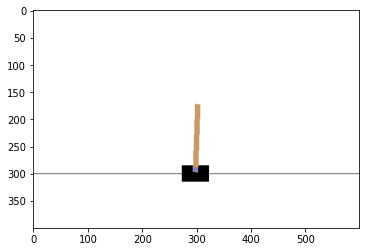

In [ ]:
# get render
prev_screen = env.render(mode='rgb_array')
plt.imshow(prev_screen)

In [ ]:
actions, obs, rewards, dones, infos = [], [], [], [], []

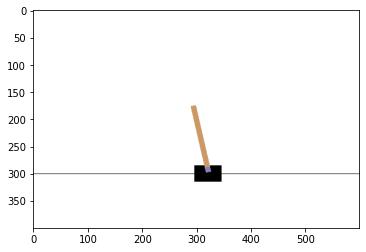

In [ ]:
for i in range(50):
  # we sample a random action from the action space
  action = env.action_space.sample()
  # we take a step with that action, and are returned the observation, reward, whether it is done, and information
  ob, reward, done, info = env.step(action)
  # storing these values so we can get a peak at them later
  actions.append(action)
  obs.append(ob)
  rewards.append(reward)
  dones.append(done)
  infos.append(info)
  # getting an rgb picture of the screen (this is only because of colab)
  screen = env.render(mode='rgb_array')
  # displaying image
  plt.imshow(screen)
  ipythondisplay.clear_output(wait=True)
  ipythondisplay.display(plt.gcf())

  if done:
    break
    
ipythondisplay.clear_output(wait=True)
env.close()

The framerate isn't great, but you get the point - the environment we are simulating is a cart pole trying to balance itself. 

Let us now look at the different values in the environment.

In [ ]:
actions

[1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 0, 0]

In [ ]:
obs

[array([-0.01344183,  0.2041424 ,  0.03500119, -0.25801893]),
 array([-0.00935898,  0.39874763,  0.02984081, -0.53945974]),
 array([-0.00138402,  0.20321918,  0.01905162, -0.23752574]),
 array([ 0.00268036,  0.39806385,  0.0143011 , -0.52413886]),
 array([ 0.01064164,  0.59298164,  0.00381833, -0.81228127]),
 array([ 0.02250127,  0.78805108, -0.0124273 , -1.10376072]),
 array([ 0.03826229,  0.98333426, -0.03450251, -1.4003164 ]),
 array([ 0.05792898,  0.7886577 , -0.06250884, -1.11861707]),
 array([ 0.07370213,  0.98454159, -0.08488118, -1.43023469]),
 array([ 0.09339296,  1.18060272, -0.11348588, -1.74819269]),
 array([ 0.11700502,  1.37681652, -0.14844973, -2.07391342]),
 array([ 0.14454135,  1.18348125, -0.189928  , -1.83058418]),
 array([ 0.16821097,  0.99090312, -0.22653968, -1.60241518])]

In [ ]:
rewards

[1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0]

In [ ]:
dones

[False,
 False,
 False,
 False,
 False,
 False,
 False,
 False,
 False,
 False,
 False,
 False,
 True]

In [ ]:
infos

[{}, {}, {}, {}, {}, {}, {}, {}, {}, {}, {}, {}, {}]

Let's take a second to look at these values returned. We have an action, which is a direction you move the cart pole, an observation, which is the state at that point (a vector), and a reward, which in our case is all positive. The loop continues until when the environment is over. This is what the documentation has to say about the variables:

- observation (object): an environment-specific object representing your observation of the environment. For example, pixel data from a camera, joint angles and joint velocities of a robot, or the board state in a board game.
- reward (float): amount of reward achieved by the previous action. The scale varies between environments, but the goal is always to increase your total reward.
- done (boolean): whether it’s time to reset the environment again. Most (but not all) tasks are divided up into well-defined episodes, and done being True indicates the episode has terminated. (For example, perhaps the pole tipped too far, or you lost your last life.)
- info (dict): diagnostic information useful for debugging. It can sometimes be useful for learning (for example, it might contain the raw probabilities behind the environment’s last state change). However, official evaluations of your agent are not allowed to use this for learning.

**This is just an implementation of the classic “agent-environment loop”. Each timestep, the agent chooses an action, and the environment returns an observation and a reward.**

### Spaces

In the examples above, we’ve been sampling random actions from the environment’s action space. But what actually are those actions? Every environment comes with an action_space and an observation_space. These attributes are of type Space, and they describe the format of valid actions and observations:

In [ ]:
print(env.action_space)


Discrete(2)


In [ ]:
print(env.observation_space)

Box(-3.4028234663852886e+38, 3.4028234663852886e+38, (4,), float32)


The Discrete space allows a fixed range of non-negative numbers, so in this case valid actions are either 0 or 1. The Box space represents an n-dimensional box, so valid observations will be an array of 4 numbers. We can also check the Box’s bounds:

In [ ]:
print(env.observation_space.high)


[4.8000002e+00 3.4028235e+38 4.1887903e-01 3.4028235e+38]


In [ ]:
print(env.observation_space.low)


[-4.8000002e+00 -3.4028235e+38 -4.1887903e-01 -3.4028235e+38]


This introspection can be helpful to write generic code that works for many different environments. Box and Discrete are the most common Spaces. You can sample from a Space or check that something belongs to it:

In [ ]:
from gym import spaces
space = spaces.Discrete(8) # Set with 8 elements {0, 1, 2, ..., 7}
x = space.sample()
assert space.contains(x)
assert space.n == 8

For CartPole-v0 one of the actions applies force to the left, and one of them applies force to the right. (Can you figure out which is which?)

Fortunately, the better your learning algorithm, the less you’ll have to try to interpret these numbers yourself.

Once again, we would recommend peaking at the docs to have a better look at how to manipulate the environment. We will be dealing with similar variables, but our settings can often be very different. 

These numbers will also start to make a lot more sense when we pair them with the agents that will be navigating this space!

Let us now quickly turn to 

# Reinforcement Learning Settings

TODO: fill in text from Reinforcement learning book.

## Model-free or Model-based

## Updating: Off Policy and On Policy

## Optimization: Value based, Policy based and Imitation based

# Markov Decision Processes, Dynamic Programming and Monte Carlo Methods

## Code-Driven Introduction to Reinforcement Learning

This is an example from the book [Reinforcement Learning](https://rl-book.com/?utm_source=winder&utm_medium=notebook&utm_campaign=rl), by Dr. Phil Winder. 

In this section you will be investigating the fundamentals of reinforcement learning (RL). The first section describes the Markov decision process (MDP), which is a framework to help you design problems. The second section formulates an RL-driven solution for the MDP.



### Expectations

In the following examples we intentionally use a very simple and visual example. This makes it easier to understand, since that is the main goal. Although there are [industrial examples](https://rl-book.com/applications/?utm_source=winder&utm_medium=notebook&utm_campaign=rl) that are similar, real-life implementations are likely to be more complex.

## Section 1. The Markov Decision Process

The Markov decision process (MDP) is a mathematical framework that helps you encapsulate the real-world. Desptite simple and restrictive -- the sign of a good interface -- a suprising number of situations can be squeezed into the MDP formalism.

### The MDP Entities

An MDP has two "entities":

- **An agent**: An application that is able to observe state and suggest an action. It also receives feedback to let it know whether the action was good, or not.
- **An environment**: This is the place where the agent acts within. It accepts an action, which alterts its internal state, and produces a new observation of that state.

In nearly all of the examples that I have seen, these two entities are implemented independently. The agent is often an RL algorithm (although not always) and the environment is either real life or a simulation.

### The MDP Interface

The agent and the environment interact through an interface. You have some control over what goes into that interface and a large amount of effort is typically spent improving the quality of the data that flows through it. You need representations of:

- **State**: This is the observation of the environment. You often get to choose what to "show" to the agent. There is a compromise between simplifying the state to speed up learning and preventing overfitting, but often it pays to include as much as you can.
- **Action**: Your agent must suggest an action. This mutates the environment in some way. So called "options" or "null-actions" allow you to do nothing, if that's what you want to do.
- **Reward**: You use the reward to fine-tune your action choices.

### Creating a "GridWorld" Environment

To make it easy to understand, I'm going to show you how to create a simulation of a simple grid-based "world". Many real-life implementations begin with a simulation of the real world, because it's much easier to iterate and improve your design with a software stub of real-life.

The goal of this environment is to define a "world" in which a "robot" can move. The so-called-world is actually a series of cells inside a 2-dimensional box. The agent can move north, east, south, or west which moves the robot between the cells. The goal of the environment is to reach a goal. There is a reward of -1 for every step, to promote reaching the goal as fast as possible.

#### Imports and Definitions

First let us import a few libraries (to enable the autocompletion in later cells) and define a few important definitions. The first is the defacto definition of a "point" object, with x and y coordinates and the second is a direction enumeration. These are use to define the position of the agent in the environment and the direction of movement for an action, respectively. Note that I'm assuming that east moves in a positive x direction and north moves in a positive y direction.

In [ ]:
from collections import defaultdict, namedtuple
from enum import Enum
from typing import Tuple, List
import random
from IPython.display import clear_output

Point = namedtuple('Point', ['x', 'y'])
class Direction(Enum):
  NORTH = "⬆"
  EAST = "⮕"
  SOUTH = "⬇"
  WEST = "⬅"

  @classmethod
  def values(self):
    return [v for v in self]

#### The Environment Class

Next I create a Python class that represents the environment. The first function in the class is the initialisation function in which we can specify the width and height of the environment.

After that I define a helper parameter which encodes the possible actions and then I reset the state of the environment with a `reset` function.

In [ ]:
class SimpleGridWorld(object):
  def __init__(self, width: int = 5, height: int = 5, debug: bool = False):
    self.width = width
    self.height = height
    self.debug = debug
    self.action_space = [d for d in Direction]
    self.reset()

#### The Reset Function

Many environments have an implicit "reset", whereby the environment's state is moved away from the goal state. In this implementation I reset the environment back to the `(0, 0)` position, but this isn't strictly necessary. Many real-life environments reset randomly or have no reset at all.

Here I also set the goal, which is located in the south-eastern corner of the environment.

In [ ]:
class SimpleGridWorld(SimpleGridWorld):
  def reset(self):
    self.cur_pos = Point(x=0, y=(self.height - 1))
    self.goal = Point(x=(self.width - 1), y=0)
    # If debug, print state
    if self.debug:
      print(self)
    return self.cur_pos, 0, False

#### Taking a Step

Recall that the MDP interface three key components: the state, the action, and the reward. The environment's step function accepts an action, then produces a new state and reward.

The large amount of code is a consequence of the direction implementation. You can refactor this to use fewer lines of code with some clever indexing. However, I think this level of verbosity helps explain what is going on. In essence, every direction moves the current position by one square. You can see the code incrementing or decrementing the x or y coordinates.

The second part of the function is testing to see if the agent is at the goal. If it is, then it signals that it is at a terminal state.

In [ ]:
class SimpleGridWorld(SimpleGridWorld):
  def step(self, action: Direction):
    # Depending on the action, mutate the environment state
    if action == Direction.NORTH:
      self.cur_pos = Point(self.cur_pos.x, self.cur_pos.y + 1)
    elif action == Direction.EAST:
      self.cur_pos = Point(self.cur_pos.x + 1, self.cur_pos.y)
    elif action == Direction.SOUTH:
      self.cur_pos = Point(self.cur_pos.x, self.cur_pos.y - 1)
    elif action == Direction.WEST:
      self.cur_pos = Point(self.cur_pos.x - 1, self.cur_pos.y)
    # Check if out of bounds
    if self.cur_pos.x >= self.width:
      self.cur_pos = Point(self.width - 1, self.cur_pos.y)
    if self.cur_pos.y >= self.height:
      self.cur_pos = Point(self.width, self.cur_pos.y - 1)
    if self.cur_pos.x < 0:
      self.cur_pos = Point(0, self.cur_pos.y)
    if self.cur_pos.y < 0:
      self.cur_pos = Point(self.cur_pos.x, 0)

    # If at goal, terminate
    is_terminal = self.cur_pos == self.goal

    # Constant -1 reward to promote speed-to-goal
    reward = -1

    # If debug, print state
    if self.debug:
      print(self)

    return self.cur_pos, reward, is_terminal

#### Visualisation

And finally, like all of data science, it is vitally important that you are able to visualise the behaviour and performance of your agent. The first step in this process is being able to visualise the agent within the environment. The next function does this by printing a textual grid, with an `x` at the agent's location, a `o` at the goal, an `@` if the agent is on top of the goal, and a `_` otherwise.

In [ ]:
class SimpleGridWorld(SimpleGridWorld):
  def __repr__(self):
    res = ""
    for y in reversed(range(self.height)):
      for x in range(self.width):
        if self.goal.x == x and self.goal.y == y:
          if self.cur_pos.x == x and self.cur_pos.y == y:
            res += "@"
          else:
            res += "o"
          continue
        if self.cur_pos.x == x and self.cur_pos.y == y:
          res += "x"
        else:
          res += "_"
      res += "\n"
    return res

### Running the Environment

To run the environment you need to instantiate the class, call reset to move the agent back to the start, then perform a series of actions to move the agent. For now let me move it manually, to make sure it is working, visualising the agent at each step. I also print the result of the step (the new state, reward, and terminal flag) for completeness.

In [ ]:
s = SimpleGridWorld(debug=True)
print("☝ This shows a simple visualisation of the environment state.\n")
s.step(Direction.SOUTH)
print(s.step(Direction.SOUTH), "⬅ This displays the state and reward from the environment 𝐀𝐅𝐓𝐄𝐑 moving.\n")
s.step(Direction.SOUTH)
s.step(Direction.SOUTH)
s.step(Direction.EAST)
s.step(Direction.EAST)
s.step(Direction.EAST)
s.step(Direction.EAST)

x____
_____
_____
_____
____o

☝ This shows a simple visualisation of the environment state.

_____
x____
_____
_____
____o

_____
_____
x____
_____
____o

(Point(x=0, y=2), -1, False) ⬅ This displays the state and reward from the environment 𝐀𝐅𝐓𝐄𝐑 moving.

_____
_____
_____
x____
____o

_____
_____
_____
_____
x___o

_____
_____
_____
_____
_x__o

_____
_____
_____
_____
__x_o

_____
_____
_____
_____
___xo

_____
_____
_____
_____
____@



(Point(x=4, y=0), -1, True)

#### Key Takeaways

There are a few key lessons that you should commit to memory:

- The **state** is an observation of the environment, which contains everything outside of the agent. For example, the agent's current position within the environment. In real world applications this could be the time of the day, the weather, data from a video camera, literally anything.
- The **reward** fully specifies the optimal solution to the problem. In real life this might be profit or the number of new customers.
- Every **action** mutates the state of the environment. This may or may not be observable.

## A Reinforcement Learning Solution to the MDP: Implementing the Monte Carlo RL Algorithm

Rather confusingly, RL, like ML, is meant both as a technique and a collection of algorithms. Exactly _when_ an algorithm becomes an RL algorithms is up for debate, but it is generally accepted that there has to be multiple steps (otherwise it would just be a bandit problem) and it attempts to quantify the value of being in a particular state.

An algorithm called the _cross-entropy method_ is an algorithm that attempts to stumble accross the goal. However, once it has then it replicates the same movements again to reach the goal. This is not stricly learning, it is memoising, so it is not an RL algorithm. However, you shouldn't discount it, because it is a very good and simple baseline. It can easily complete very sophisticated tasks if you give it enough time.

Instead, let us introduce a slight variation to this algorithm called the Monte Carlo (MC) method. This lies at the heart of all modern RL algorithms so it is a great way to start.

In short -- you can read more about this in Chapter 2 of the book -- MC methods attempt to randomly sample states and judge their value. Once you have sampled the states enough times then you can derive a strategy that follows the path of the next best value.

Let's give it a try.

### Generating trajectories

Monte Carlo techniques operate by sampling the environment. In general, the idea is that if you can sample the environment enough times, you can begin to build a picture of the output, given any input. We can use this idea in RL. If we capture enough _trajectories_, where a trajectory is one full pass through an environment, then we can see which states are advantagous.

To begin, we will create a class that is capable of generating trajectories. Here I pass in the environment, then in the `run` function we repeatedly step in the environment using a random action. We store each step in a list and return it to the user.

In [ ]:
class MonteCarloGeneration(object):
  def __init__(self, env: object, max_steps: int = 1000, debug: bool = False):
    self.env = env
    self.max_steps = max_steps
    self.debug = debug

  def run(self) -> List:
    buffer = []
    n_steps = 0 # Keep track of the number of steps so I can bail out if it takes too long
    state, _, _ = self.env.reset() # Reset environment back to start
    terminal = False
    while not terminal: # Run until terminal state
      action = random.choice(self.env.action_space) # Random action. Try replacing this with Direction.EAST
      next_state, reward, terminal = self.env.step(action) # Take action in environment
      buffer.append((state, action, reward)) # Store the result
      state = next_state # Ready for the next step
      n_steps += 1
      if n_steps >= self.max_steps:
        if self.debug:
          print("Terminated early due to large number of steps")
        terminal = True # Bail out if we've been working for too long
    return buffer

#### Visualising Trajectories

As before, it's vitally important to visualise as much as possible, to gain an intuition into your problem. A simple first step is to view the agent's movement and trajectory. Here I severely limit the amount of exploration to save reams of output. Depending on your random seed you will see the agent stumbling around.

In [ ]:
env = SimpleGridWorld(debug=True) # Instantiate the environment
generator = MonteCarloGeneration(env=env, max_steps=10, debug=True) # Instantiate the generation
trajectory = generator.run() # Generate a trajectory
print([t[1].value for t in trajectory]) # Print chosen actions
print(f"total reward: {sum([t[2] for t in trajectory])}") # Print final reward

x____
_____
_____
_____
____o

x____
_____
_____
_____
____o

_____
x____
_____
_____
____o

x____
_____
_____
_____
____o

_____
_____
_____
_____
____o

____x
_____
_____
_____
____o

___x_
_____
_____
_____
____o

_____
___x_
_____
_____
____o

_____
____x
_____
_____
____o

_____
_____
____x
_____
____o

_____
_____
_____
____x
____o

_____
_____
_____
____x
____o

Terminated early due to large number of steps
['⬇', '⬆', '⬆', '⬅', '⬅', '⬇', '⮕', '⬇', '⬇', '⮕']
total reward: -10


### Quantifying Value

There's an important quanity called the _action value function_. In summary, it is a measure of the value of taking a particular action, given all the experience. In other words, you can look at the previous trajectories, find out which of them lead to the highest values and look to use them again. See Chapter 2 in the book for more details.

To generate an estimate of this value, generate a full trajectory, then look at how far away the agent is from the terminal states at all steps.

So this means we need a class to generate a full trajectory, from start to termination. That code is below. First I create a new class that accepts the generator from before; I'll use this later to generate the full trajectory.

Then I create two fields to retain the experience observed by the agent. The first is recording the expected value at each state. This is the effectively the distance to the goal. The second is recording the number of times the agent has visited that state.

Then I create a helper function to return a key for the dictionary (a.k.a. map) and an action value function to calculate the value of taking each action in each state. This is simply the average value over all visits.

In [ ]:
class MonteCarloExperiment(object):
  def __init__(self, generator: MonteCarloGeneration):
    self.generator = generator
    self.values = defaultdict(float)
    self.counts = defaultdict(float)

  def _to_key(self, state, action):
    return (state, action)
  
  def action_value(self, state, action) -> float:
    key = self._to_key(state, action)
    if self.counts[key] > 0:
      return self.values[key] / self.counts[key]
    else:
      return 0.0

Next I create a function to store this data after generating a full trajectory. There are several important parts of this function.

The first is that I'm using reversed trajectories. I.e. I'm starting from the end and working backwards.

The second is that I'm averaging the expected return over all visits. So this is reporting the value of an action, on average.

In [ ]:
class MonteCarloExperiment(MonteCarloExperiment):
  def run_episode(self) -> None:
    trajectory = self.generator.run() # Generate a trajectory
    episode_reward = 0
    for i, t in enumerate(reversed(trajectory)): # Starting from the terminal state
      state, action, reward = t
      key = self._to_key(state, action)
      episode_reward += reward  # Add the reward to the buffer
      self.values[key] += episode_reward # And add this to the value of this action
      self.counts[key] += 1 # Increment counter

#### Running the Trajectory Generation

Let's test this by setting some expectations. We're reporting the value of taking an action **on average**. So on average, you would expect the value of taking the `EAST` action when next to the terminal state would be -1, because it's right there, it's a single step and therefore a single reward of -1 to get to the terminal state.

However, other directions will not be -1, because the agent will continue to stumble around.

In [ ]:
env = SimpleGridWorld(debug=False) # Instantiate the environment - set the debug to true to see the actual movemen of the agent.
generator = MonteCarloGeneration(env=env, debug=True) # Instantiate the trajectory generator
agent = MonteCarloExperiment(generator=generator)
for i in range(4):
  agent.run_episode()
  print(f"Run {i}: ", [agent.action_value(Point(3,0), d) for d in env.action_space])

Run 0:  [0.0, -1.0, 0.0, -8.0]
Run 1:  [0.0, -1.0, 0.0, -8.0]
Run 2:  [-7.0, -1.0, 0.0, -5.5]
Run 3:  [-13.0, -1.0, -14.0, -5.5]


So you can see from above that yes, when choosing east from the point to the west of the terminal state the expected return is -1. But notice that the agent (probably) did not observe that result straight away, because it takes time to randomly select it. (Run it a few more times to see what happens, you'll see random changes)

#### Visualising the State Value Function

The state value function is the average expected return for all actions. In general, you should see that the value increases the closer you get to the goal. But because of the random movement, especially far away from the goal, there will be a lot of noise.

Below I create a helper function to plot this.

In [ ]:
def state_value_2d(env, agent):
    res = ""
    for y in reversed(range(env.height)):
      for x in range(env.width):
        if env.goal.x == x and env.goal.y == y:
          res += "   @  "
        else:
          state_value = sum([agent.action_value(Point(x,y), d) for d in env.action_space]) / len(env.action_space)
          res += f'{state_value:6.2f}'
        res += " | "
      res += "\n"
    return res

print(state_value_2d(env, agent))

-44.73 | -11.50 |  -5.00 | -25.75 | -30.49 | 
-40.58 | -22.88 | -15.25 | -34.71 | -27.36 | 
-12.67 | -10.67 | -10.50 | -22.50 | -19.44 | 
-14.79 | -13.38 | -15.00 | -20.40 | -17.38 | 
-19.34 | -18.50 | -13.62 |  -8.38 |    @   | 



### Generating Optimal Policies

A _policy_ is a set of rules that an agent should follow. It is a strategy that works for that particular environment. You can now generate thousands of trajectories and track the expected value over time.

With enough averaging, the expected values should present a clear picture of what the optimal policy is. See if you can see what it is?

In the code below I'm instantiating all the previous code and then generating 1000 episodes. Then I print out the state value function for every position.

In [ ]:
env = SimpleGridWorld() # Instantiate the environment
generator = MonteCarloGeneration(env=env) # Instantiate the trajectory generator
agent = MonteCarloExperiment(generator=generator)
for i in range(1000):
  clear_output(wait=True)
  agent.run_episode()
  print(f"Iteration: {i}")
  # print([agent.action_value(Point(0,4), d) for d in env.action_space]) # Uncomment this line to see the actual values for a particular state
  print(state_value_2d(env, agent), flush=True)
  # time.sleep(0.1) # Uncomment this line if you want to see every episode

Iteration: 999
-78.43 | -74.84 | -75.18 | -74.59 | -73.22 | 
-78.60 | -75.15 | -74.70 | -71.49 | -71.07 | 
-80.83 | -73.45 | -70.77 | -64.85 | -61.74 | 
-78.66 | -74.20 | -69.07 | -53.74 | -43.05 | 
-78.70 | -72.13 | -63.13 | -36.13 |    @   | 



#### Plotting the Optimal Policy

That's right! The optimal policy is to choose the action that picks the highest expected return. In other words, you want to move the agent towards regions of higher reward.

Let me create another helper function to visualise where the maximal actions are pointing...

In [ ]:
def argmax(a):
    return max(range(len(a)), key=lambda x: a[x])

def next_best_value_2d(env, agent):
    res = ""
    for y in reversed(range(env.height)):
      for x in range(env.width):
        if env.goal.x == x and env.goal.y == y:
          res += "@"
        else:
          # Find the action that has the highest value
          loc = argmax([agent.action_value(Point(x,y), d) for d in env.action_space])
          res += f'{env.action_space[loc].value}'
        res += " | "
      res += "\n"
    return res

print(next_best_value_2d(env, agent))

⬆ | ⬇ | ⬅ | ⬇ | ⬇ | 
⬅ | ⬆ | ⬇ | ⬇ | ⬇ | 
⮕ | ⮕ | ⮕ | ⬇ | ⬇ | 
⮕ | ⮕ | ⮕ | ⬇ | ⬇ | 
⮕ | ⮕ | ⮕ | ⮕ | @ | 



And there you have it. A policy. The above image spells out what the agent should do in each state. It should move towards regions of higher value. You can see (in general) that the arrows are all pointing towards the goal, as if by magic.

For the arrows that are not, that is a more interesting story. The problem is that the agent is still entirely random at this point. It's stumbling around until it reachest the goal. The agent started in the top left, so on average, it takes a _lot_ of stumbling to find the goal.

Therefore, for the points at the top left, furthest away from the goal, the agent will probably take many more random steps before it reachest the goal. In essence, it _doesn't matter which way the agent goes_. It will still take a long time to get there.

Subsequent Monte Carlo algorithms fix this by updating the action value function every episode and using this knowledge to choose the action. So latter iterations of the agent are far more guided and intelligent.

#### One Final Run

To wrap this up, let me run the whole thing one more time. I will plot the state value function and the policy for all iteration steps. Watch how it changes over time. Add a sleep to slow it down to see it changing on each step.

In [ ]:
env = SimpleGridWorld() # Instantiate the environment
generator = MonteCarloGeneration(env=env) # Instantiate the trajectory generator
agent = MonteCarloExperiment(generator=generator)
for i in range(1000):
  clear_output(wait=True)
  agent.run_episode()
  print(f"Iteration: {i}")
  print(state_value_2d(env, agent))
  print(next_best_value_2d(env, agent), flush=True)
  # time.sleep(0.1) # Uncomment this line if you want to see the iterations

Iteration: 999
-83.81 | -82.24 | -81.58 | -81.81 | -79.21 | 
-87.66 | -84.94 | -80.75 | -79.07 | -77.20 | 
-86.06 | -82.90 | -74.89 | -69.01 | -65.00 | 
-84.64 | -81.34 | -67.66 | -56.00 | -43.77 | 
-76.32 | -78.16 | -63.25 | -39.12 |    @   | 

⬅ | ⬆ | ⬆ | ⬇ | ⬇ | 
⮕ | ⬇ | ⬇ | ⬇ | ⬇ | 
⮕ | ⮕ | ⬇ | ⬇ | ⬇ | 
⬇ | ⮕ | ⮕ | ⬇ | ⬇ | 
⬇ | ⮕ | ⮕ | ⮕ | @ | 



## Summary and Next Steps

I appreciate that this might be the first time that you have encountered Monte Carlo (MC) techniques or RL. So I have intentionally made this notebook as simple and free of libraries as possible, to gain experience at the coal-face.

This obviously means that the actual algorithm isn't that intelligent. For example, MC techniques usually go through two phases, policy evaluation, where full trajectories are captured, then policy improvement, where a new policy is derived. This helps stabilise and speed up learning, beacuse you are learning on every episode.

Subsequent algorithms then take this idea further and update the policy on every _step_, which is called _bootstrapping_ which supercharges the RL algorithm to produce _temporal difference_ algorithms (see Chapter 3 in the book).

But I'm getting ahead of myself. I really do encourage you to play around with this code and tinker with the results. Here are some things that you can try:

- Increase or decrease the size of the grid.
- Add other terminating states
- Change the reward to a different value
- Change the reward to produce 0 reward per step, and a positive reward for the terminating state
- Add a terminating state with a massive negative reward, to simulate a cliff
- Add a hole in the middle
- Add a wall
- See if you can add the code to use the policy derived by the agent

And of course, there's far more details in the book. Please [consider buying it](https://rl-book.com/?utm_source=winder&utm_medium=notebook&utm_campaign=rl) if you want to learn more. Good luck!

# Bandit Learning

https://github.com/tensorflow/agents/blob/master/docs/tutorials/bandits_tutorial.ipynb

## E-Greedy and Bandit Algorithms

Bandit algorithms provide a way to optimize single competing actions in the shortest amount of time. Imagine you are attempting to find out which advert provides the best click through rate of which button provides the most sales. You could show two ads and count the number of clicks on each, over a one week period. But this means that many people would see a sub-optimal ad. Instead, you can learn over time and progressively shift the shown advert towards the one that is performing better. For more information see the references in the book.

## The Testing Environment

In this workshop I will leverage a bandit library to simulate the behaviour and provide the first algorithm that chooses an action. I do this to get you up and running quickly, and because bandits are not the core focus of this book.

First let me install the library and define the simulated behaviour of the users.


In [ ]:
!pip install banditsbook==0.1.1 > /dev/null

In [ ]:
from arms.bernoulli import BernoulliArm

# Define two adverts, with a probability of clicking from the users
# This is a simulation. Imagine that these are real ads.
arm0 = BernoulliArm(0.05)
arm1 = BernoulliArm(0.4)
arms = [arm0, arm1]

This is an important definition, which glosses over a few important aspects. Primarily, these simulations are responsible for providing a reward whenever the simulated person performs an action. Sometimes the reward is a 0, when they don't click, other times it's a 1 when they do. Look:

In [ ]:
[arm1.draw() for _ in range(5)]

[1.0, 0.0, 1.0, 0.0, 0.0]

## Running the Experiment With a Random Algorithm

Now we have the "environment" simulated, we can run various algorithms to see how often the optimal action is presented to the user.

A great baseline is a random agent, so let's try that first.

But I need a bit of supporting code, because I'm not interested in raw decisions. I want to see how often button 2 was chosen. To do this, I will repeat the experiment 1000 times, and measure the proportion of time ad 2 was chosen.

In [ ]:
import pandas as pd
from algorithms.epsilon_greedy.standard import EpsilonGreedy
from testing_framework.tests import test_algorithm

epsilon = 1 # Choose a random action every time
num_sims = 1000 # Number of repetitions
horizon = 250 # Length of experiment

df = pd.DataFrame() # Buffer
algo1 = EpsilonGreedy(epsilon, [], []) # Algorithm
sim_nums, times, chosen_arms, rewards, cumulative_rewards = test_algorithm(
        algo1, arms, num_sims, horizon) # Running the environment/algorithm via the library
arrays = [[epsilon] * num_sims * horizon, sim_nums, times] # Constructing the output array for aggregation
index = pd.MultiIndex.from_arrays(
        arrays, names=('epsilon', 'simulation', 'time'))
df_chosen_arm = pd.DataFrame(chosen_arms, index=index)
df_chosen_arm = df_chosen_arm.groupby(level=[0, 2]).sum() / num_sims # Aggregating to result in the proportion of time
df = df.append(df_chosen_arm) # Append to buffer.

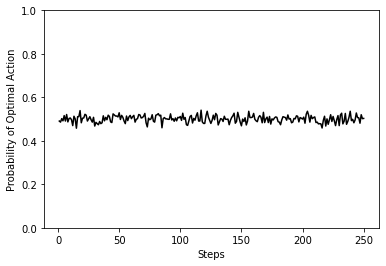

In [ ]:
import matplotlib

df.loc[1].plot(legend=None,ylim=[0,1],ylabel="Probability of Optimal Action",xlabel="Steps",color="k");

As you can see, the optimal action is being selected half of the time, on average. This is the expected result for a random agent with two actions.

## Running the Experiment with Several Algorithms

Now let's try and repeat with several different values of epsilon, the value that chooses the amount of time the algorithm chooses a random action. An epsilon of 0 would never choose a random action.

In [ ]:
df = pd.DataFrame()
for epsilon in [0, 0.1, 0.5, 1]:
    algo1 = EpsilonGreedy(epsilon, [], [])
    sim_nums, times, chosen_arms, rewards, cumulative_rewards = test_algorithm(
        algo1, arms, num_sims, horizon)

    arrays = [[epsilon] * num_sims * horizon, sim_nums, times]
    index = pd.MultiIndex.from_arrays(
        arrays, names=('epsilon', 'simulation', 'time'))
    df_chosen_arm = pd.DataFrame(chosen_arms, index=index)
    df_chosen_arm = df_chosen_arm.groupby(level=[0, 2]).sum() / num_sims
    df = df.append(df_chosen_arm)

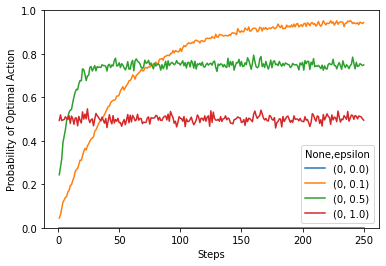

In [ ]:
df.unstack(level=0).plot(ylim=[0,1],ylabel="Probability of Optimal Action",xlabel="Steps");

Now there are several plots with different values of epsilon. You can see that when epsilon (the probability of exploration) is zero, then the agent never picks the optimal action. This is a bit of an implementation bug. The first time the agent picks an agent, it should be random. Eventualy, one of those actions is rewarding and it will subsequently pick the same action over an over again, without exploring other options.

Another thing you will notice is the speed of convergence. The less exploration there is, the longer it will take to reach an optimal value.


## Comparing Simple Exploration Techniques: ε-Greedy, Annealing, and UCB

Following on from the previous experiment with ε-Greedy methods, the next question is, can we explore more intelligently?

The answer is yes, and you can read more about it in the book. But in essence, bandits generally use three forms of exploration. Standard ε-Greedy, which randomly chooses an action some proportion of the time, and annealing version, which reduces the exploration over time, and finally UCB, which chooses an action depending on how often the action has been sampled.

## The Testing Environment

I will reuse the environment from the previous ε-Greedy experiment. See that workshop for more details.

In [ ]:
!pip install banditsbook==0.1.1 pandas==1.1.2 matplotlib==3.3.2 &2> /dev/null

In [ ]:
from arms.bernoulli import BernoulliArm

# Define two adverts, with a probability of clicking from the users
# This is a simulation. Imagine that these are real ads.
arm0 = BernoulliArm(0.05)
arm1 = BernoulliArm(0.4)
arms = [arm0, arm1]

## Running the Experiment

The code below will compare the three algorithms on the simulated environment. 

In [ ]:
from arms.bernoulli import BernoulliArm
from testing_framework.tests import test_algorithm
from algorithms.epsilon_greedy.standard import EpsilonGreedy
from algorithms.softmax.annealing import AnnealingSoftmax
from algorithms.ucb.ucb1 import UCB1
import pandas as pd
import random

random.seed(42)

num_sims = 1000 # Repetitions
horizon = 250 # Number of steps in experiment
n_arms = len(arms)

algo1 = AnnealingSoftmax([], []) # Annealing ε-Greedy
algo1.initialize(n_arms)
algo2 = EpsilonGreedy(0.05, [], []) # Standard ε-Greedy, exploring 5% of the time
algo3 = UCB1([], []) # UCB
algo3.initialize(n_arms)
algos = [("e_greedy", algo2), ("annealing_softmax", algo1), ("ucb", algo3)]

# A bit of code to loop over each algorithm and average the results
df = pd.DataFrame()
for algo in algos:
    sim_nums, times, chosen_arms, rewards, cumulative_rewards = test_algorithm(
        algo[1], arms, num_sims, horizon)
    arrays = [sim_nums, times]
    index = pd.MultiIndex.from_arrays(
        arrays, names=('simulation', 'time'))
    df_chosen_arm = pd.DataFrame(chosen_arms, index=index, columns=[algo[0]])
    df_probability_selected = df_chosen_arm.groupby(level=1).sum() / num_sims
    df = pd.concat([df, df_probability_selected], axis=1)

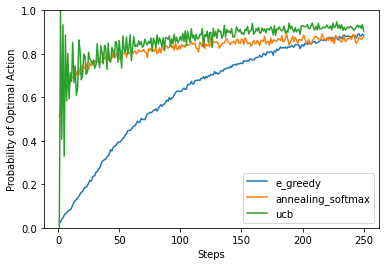

In [ ]:
df.plot(ylim=[0,1],ylabel="Probability of Optimal Action",xlabel="Steps");

You can see that the ε-Greedy algorithm is taking a long time to converge to a similar level of performance. The reason being that it is still spending a large proportion of the time chossing random actions.

The annealing version rapidly reduces the amount of random exploration to speed this learning up. This is better, but you need to tune the hyper-parameters (initial exploration rate, final exploration rate and how fast to anneal) for your specific problem.

UCB attempts to quantify the number of times that action/state has been explored. If it has been explored a lot, and it is not the best action, then there's little point in exploring more. This is good because there are no hyper-parameters but you'll need to store a representation
UCB attempts to quantify the number of times that action/state has been explored. If it has been explored a lot, and it is not the best action, then there's little point in exploring more. This is good because there are no hyper-parameters but you'll need to store visitation counts; something that might not be possible for certain problems.

# Temporal Difference Learning

Temporal difference (TD) learning is a method to improve the current state estimate using estimates of future states. The underlying assumption is that by having some knowledge about the state transition, which is the reward $r$ from the current to next state, we can have a better estimation of the current state return. 
$$
V^{\pi}(s) \leftarrow V^{\pi}(s)+\alpha (r+\gamma V^{\pi}(s') -V^{\pi}(s))
$$
Here, $s$ is the current state and $s'$ is the next state. 





### TD Estimate

We refer to the term $V^{\pi}(s)$ as the *TD Estimate*. This is the estimated value function of current state. 




### TD Target

We refer to the term $r+\gamma V^{\pi}(s')$ as the *TD Target*. This is the target value function that we want to optimize *TD Estimate* towards to. *TD Target* is calculated based on value estimate of next state and current reward. By incorporating the additional information $r$, *TD Target* is a more accurate estimate than *TD Estimate*. Drawing an analogy to supervised learning, $r+\gamma V^{\pi}(s')$ is assumed to be the *label*, and  $V^{\pi}(s)$ is the *prediction*. 

TD learning could be applied for both value function $V^{\pi}(s)$ and value action function $Q^{\pi}(s, a)$. In the case for $Q^{\pi}(s, a)$, TD learning goes as following.
$$
Q^{\pi}(s, a) \leftarrow Q^{\pi}(s, a)+\alpha (r+\gamma Q^{\pi}(s', a') -Q^{\pi}(s, a))
$$


# Q-learning

Q-learning is the result of combining TD learning with optimal Bellman equation. With the philosophy of TD learning, Q-learning builds a better estimate of current state-action pair by using reward information and optimal estimate for the next state-action pair. 
$$
Q^*(s, a) \leftarrow Q^*(s, a)+\alpha (r + \gamma \max_{a'} Q^*(s', a') -Q^*(s, a))
$$
Note that the term $r + \gamma \max_{a'} Q^*(s', a')$ is what we defined as *TD target* above. Under TD learning, this *TD target* gives a better estimate of current state-action pair, so we want to update our *TD estimate*, $Q^*(s, a)$, towards it. In other words, we want to minimize the difference between *TD estimate* $Q^*(s, a)$ and *TD target* $r + \gamma \max_{a'} Q^*(s', a')$. 

$$
L(\theta) = (r + \gamma \max_{a'} Q_{\theta}^*(s', a') -Q_{\theta}^*(s, a))^2
$$
As we frequently use a neural network for the optimal action value function $Q^*(s', a')$, $\theta$ here represents the neural network parameters. The goal is to minimize the loss $L(\theta)$ with respect to $\theta$ so that $Q_{\theta}^*(s, a)$ approaches $r + \gamma \max_{a'} Q_{\theta}^*(s', a')$. 


## Q-Learning example

We will using the material from module 12 of the [Deep Learning](https://sites.wustl.edu/jeffheaton/t81-558/) course at  [Washington University in St. Louis](https://engineering.wustl.edu/Programs/Pages/default.aspx), by  [Jeff Heaton](https://sites.wustl.edu/jeffheaton/).

### Google CoLab Instructions

The following code ensures that Google CoLab is running the correct version of TensorFlow.

In [ ]:
try:
    from google.colab import drive
    %tensorflow_version 2.x
    COLAB = True
    print("Note: using Google CoLab")
except:
    print("Note: not using Google CoLab")
    COLAB = False

Note: using Google CoLab


In [ ]:
if COLAB:
  !sudo apt-get install -y xvfb ffmpeg x11-utils
  !pip install -q 'gym==0.10.11'
  !pip install -q 'imageio==2.4.0'
  !pip install -q PILLOW
  !pip install -q 'pyglet==1.3.2'
  !pip install -q pyvirtualdisplay
  !pip install -q tf-agents

Reading package lists... Done
Building dependency tree       
Reading state information... Done
x11-utils is already the newest version (7.7+3build1).
ffmpeg is already the newest version (7:3.4.6-0ubuntu0.18.04.1).
xvfb is already the newest version (2:1.19.6-1ubuntu4.4).
0 upgraded, 0 newly installed, 0 to remove and 31 not upgraded.


### Introduction to Q-Learning

Q-Learning is a foundational technique upon which deep reinforcement learning is based.  Before we explore deep reinforcement learning, it is essential to understand Q-Learning.  Several components make up any Q-Learning system.

* **Agent** - The agent is an entity that exists in an environment that takes actions to affect the state of the environment, to receive rewards.
* **Environment** - The environment is the universe that the agent exists in.  The environment is always in a specific state that is changed by the actions of the agent.
* **Actions** - Steps that can be performed by the agent to alter the environment 
* **Step** - A step occurs each time that the agent performs an action and potentially changes the environment state.
* **Episode** - A chain of steps that ultimately culminates in the environment entering a terminal state.
* **Epoch** - A training iteration of the agent that contains some number of episodes.
* **Terminal State** -  A state in which further actions do not make sense.  In many environments, a terminal state occurs when the agent has one, lost, or the environment exceeding the maximum number of steps.

Q-Learning works by building a table that suggests an action for every possible state.  This approach runs into several problems.  First, the environment is usually composed of several continuous numbers, resulting in an infinite number of states. Q-Learning handles continuous states by binning these numeric values into ranges. 

Additionally, Q-Learning primarily deals with discrete actions, such as pressing a joystick up or down.  Out of the box, Q-Learning does not deal with continuous inputs, such as a car's accelerator that can be in a range of positions from released to fully engaged. Researchers have come up with clever tricks to allow Q-Learning to accommodate continuous actions.

In the next chapter, we will learn more about deep reinforcement learning. Deep neural networks can help to solve the problems of continuous environments and action spaces.  For now, we will apply regular Q-Learning to the Mountain Car problem from OpenAI Gym.

### Introducing the Mountain Car

This section will demonstrate how Q-Learning can create a solution to the mountain car gym environment.  The Mountain car is an environment where a car must climb a mountain.  Because gravity is stronger than the car's engine, even with full throttle, it cannot merely accelerate up the steep slope. The vehicle is situated in a valley and must learn to utilize potential energy by driving up the opposite hill before the car can make it to the goal at the top of the rightmost hill.

First, it might be helpful to visualize the mountain car environment.  The following code shows this environment.  This code makes use of TF-Agents to perform this render. Usually, we use TF-Agents for the type of deep reinforcement learning that we will see in the next module.  However, for now, TF-Agents is just used to render the mountain care environment.

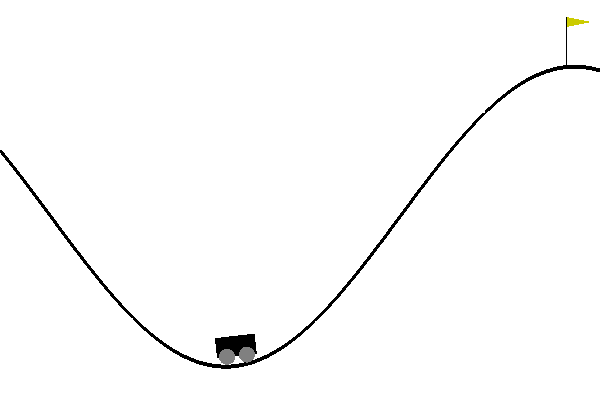

In [ ]:
import tf_agents
from tf_agents.environments import suite_gym
import PIL.Image
import pyvirtualdisplay

display = pyvirtualdisplay.Display(visible=0, size=(1400, 900)).start()

env_name = 'MountainCar-v0'
env = suite_gym.load(env_name)
env.reset()
PIL.Image.fromarray(env.render())

The mountain car environment provides the following discrete actions:

* 0 - Apply left force
* 1 - Apply no force
* 2 - Apply right force

The mountain car environment is made up of the following continuous values:

* state[0] - Position 
* state[1] - Velocity

The following code shows an agent that applies full throttle to climb the hill.  The cart is not strong enough.  It will need to use potential energy from the mountain behind it.

In [ ]:
import gym
from gym.wrappers import Monitor
import glob
import io
import base64
from IPython.display import HTML
from pyvirtualdisplay import Display
from IPython import display as ipythondisplay

display = Display(visible=0, size=(1400, 900))
display.start()

"""
Utility functions to enable video recording of gym environment 
and displaying it.
To enable video, just do "env = wrap_env(env)""
"""

def show_video():
  mp4list = glob.glob('video/*.mp4')
  if len(mp4list) > 0:
    mp4 = mp4list[0]
    video = io.open(mp4, 'r+b').read()
    encoded = base64.b64encode(video)
    ipythondisplay.display(HTML(data='''<video alt="test" autoplay 
                loop controls style="height: 400px;">
                <source src="data:video/mp4;base64,{0}" type="video/mp4" />
             </video>'''.format(encoded.decode('ascii'))))
  else: 
    print("Could not find video")
    

def wrap_env(env):
  env = Monitor(env, './video', force=True)
  return env

In [ ]:
import gym

if COLAB:
  env = wrap_env(gym.make("MountainCar-v0"))
else:
  env = gym.make("MountainCar-v0")

env.reset()
done = False

i = 0
while not done:
    i += 1
    state, reward, done, _ = env.step(2)
    env.render()
    print(f"Step {i}: State={state}, Reward={reward}")
    
env.close()

Step 1: State=[-0.55754837  0.00126361], Reward=-1.0
Step 2: State=[-0.55503058  0.00251779], Reward=-1.0
Step 3: State=[-0.5512774   0.00375318], Reward=-1.0
Step 4: State=[-0.54631687  0.00496053], Reward=-1.0
Step 5: State=[-0.54018608  0.00613078], Reward=-1.0
Step 6: State=[-0.53293095  0.00725514], Reward=-1.0
Step 7: State=[-0.52460583  0.00832512], Reward=-1.0
Step 8: State=[-0.51527315  0.00933267], Reward=-1.0
Step 9: State=[-0.50500292  0.01027024], Reward=-1.0
Step 10: State=[-0.49387208  0.01113084], Reward=-1.0
Step 11: State=[-0.48196389  0.01190819], Reward=-1.0
Step 12: State=[-0.46936715  0.01259674], Reward=-1.0
Step 13: State=[-0.45617536  0.01319179], Reward=-1.0
Step 14: State=[-0.44248581  0.01368956], Reward=-1.0
Step 15: State=[-0.42839861  0.01408719], Reward=-1.0
Step 16: State=[-0.41401575  0.01438286], Reward=-1.0
Step 17: State=[-0.39944004  0.01457571], Reward=-1.0
Step 18: State=[-0.38477414  0.0146659 ], Reward=-1.0
Step 19: State=[-0.37011958  0.014654

In [ ]:
show_video()

### Programmed Car

Now we will look at a car that I hand-programmed.  This car is straightforward; however, it solves the problem. The programmed car always applies force to one direction or another.  It does not break.  Whatever direction the vehicle is currently rolling, the agent uses power in that direction.  Therefore, the car begins to climb a hill, is overpowered, and turns backward.  However, once it starts to roll backward force is immediately applied in this new direction.

The following code implements this preprogrammed car.

In [ ]:
import gym

if COLAB:
  env = wrap_env(gym.make("MountainCar-v0"))
else:
  env = gym.make("MountainCar-v0")
  
state = env.reset()
done = False

i = 0
while not done:
    i += 1
    
    if state[1]>0:
        action = 2
    else:
        action = 0
    
    state, reward, done, _ = env.step(action)
    env.render()
    print(f"Step {i}: State={state}, Reward={reward}")
    
env.close()

Step 1: State=[-0.57730941 -0.00060338], Reward=-1.0
Step 2: State=[-0.5785117  -0.00120229], Reward=-1.0
Step 3: State=[-0.580304  -0.0017923], Reward=-1.0
Step 4: State=[-0.58267307 -0.00236906], Reward=-1.0
Step 5: State=[-0.58560139 -0.00292832], Reward=-1.0
Step 6: State=[-0.58906736 -0.00346598], Reward=-1.0
Step 7: State=[-0.59304548 -0.00397811], Reward=-1.0
Step 8: State=[-0.5975065  -0.00446102], Reward=-1.0
Step 9: State=[-0.60241775 -0.00491125], Reward=-1.0
Step 10: State=[-0.60774335 -0.0053256 ], Reward=-1.0
Step 11: State=[-0.61344454 -0.00570119], Reward=-1.0
Step 12: State=[-0.61948002 -0.00603548], Reward=-1.0
Step 13: State=[-0.62580627 -0.00632625], Reward=-1.0
Step 14: State=[-0.63237791 -0.00657165], Reward=-1.0
Step 15: State=[-0.63914812 -0.00677021], Reward=-1.0
Step 16: State=[-0.64606896 -0.00692084], Reward=-1.0
Step 17: State=[-0.65309179 -0.00702284], Reward=-1.0
Step 18: State=[-0.66016768 -0.00707588], Reward=-1.0
Step 19: State=[-0.66724771 -0.00708003

We now visualize the preprogrammed car solving the problem.

In [ ]:
show_video()

### Reinforcement Learning

Q-Learning is a system of rewards that the algorithm gives an agent for successfully moving the environment into a state considered successful.  These rewards are the Q-values from which this algorithm takes its name.  The final output from the Q-Learning algorithm is a table of Q-values that indicate the reward value of every action that the agent can take, given every possible environment state. The agent must bin continuous state values into a fixed finite number of columns.

Learning occurs when the algorithm runs the agent and environment through a series of episodes and updates the Q-values based on the rewards received from actions taken; Figure 12.REINF provides a high-level overview of this reinforcement or Q-Learning loop.

**Figure 12.REINF:Reinforcement/Q Learning**
![Reinforcement Learning](https://raw.githubusercontent.com/jeffheaton/t81_558_deep_learning/master/images/reinforcement.png "Reinforcement Learning")

The Q-values can dictate action by selecting the action column with the highest Q-value for the current environment state.  The choice between choosing a random action and a Q-value driven action is governed by the epsilon ($\epsilon$) parameter, which is the probability of random action.

Each time through the training loop, the training algorithm updates the Q-values according to the following equation.


$Q^{new}(s_{t},a_{t}) \leftarrow \underbrace{Q(s_{t},a_{t})}_{\text{old value}} + \underbrace{\alpha}_{\text{learning rate}} \cdot  \overbrace{\bigg( \underbrace{\underbrace{r_{t}}_{\text{reward}} + \underbrace{\gamma}_{\text{discount factor}} \cdot \underbrace{\max_{a}Q(s_{t+1}, a)}_{\text{estimate of optimal future value}}}_{\text{new value (temporal difference target)}} - \underbrace{Q(s_{t},a_{t})}_{\text{old value}} \bigg) }^{\text{temporal difference}}$

There are several parameters in this equation:
* alpha ($\alpha$) - The learning rate, how much should the current step cause the Q-values to be updated.
* lambda ($\lambda$) - The discount factor is the percentage of future reward that the algorithm should consider in this update.

This equation modifies several values:

* $Q(s_t,a_t)$ - The Q-table.  For each combination of states, what reward would the agent likely receive for performing each action?
* $s_t$ - The current state.
* $r_t$ - The last reward received.
* $a_t$ - The action that the agent will perform.

The equation works by calculating a delta (temporal difference) that the equation should apply to the old state.  This learning rate ($\alpha$) scales this delta.  A learning rate of 1.0 would fully implement the temporal difference to the Q-values each iteration and would likely be very chaotic.

There are two parts to the temporal difference: the new and old values.  The new value is subtracted from the old value to provide a delta; the full amount that we would change the Q-value by if the learning rate did not scale this value.  The new value is a summation of the reward received from the last action and the maximum of the Q-values from the resulting state when the client takes this action. It is essential to add the maximum of action Q-values for the new state because it estimates the optimal future values from proceeding with this action. 

### Q-Learning Car

We will now use Q-Learning to produce a car that learns to drive itself.  Look out, Tesla!  We begin by defining two essential functions.


In [ ]:
import gym
import numpy as np

# This function converts the floating point state values into 
# discrete values. This is often called binning.  We divide 
# the range that the state values might occupy and assign 
# each region to a bucket.
def calc_discrete_state(state):
    discrete_state = (state - env.observation_space.low)/buckets
    return tuple(discrete_state.astype(np.int))  

# Run one game.  The q_table to use is provided.  We also 
# provide a flag to indicate if the game should be 
# rendered/animated.  Finally, we also provide
# a flag to indicate if the q_table should be updated.
def run_game(q_table, render, should_update):
    done = False
    discrete_state = calc_discrete_state(env.reset())
    success = False
    
    while not done:
        # Exploit or explore
        if np.random.random() > epsilon:
            # Exploit - use q-table to take current best action 
            # (and probably refine)
            action = np.argmax(q_table[discrete_state])
        else:
            # Explore - t
            action = np.random.randint(0, env.action_space.n)
            
        # Run simulation step
        new_state, reward, done, _ = env.step(action)
        
        # Convert continuous state to discrete
        new_state_disc = calc_discrete_state(new_state)

        # Have we reached the goal position (have we won?)?
        if new_state[0] >= env.unwrapped.goal_position:
            success = True
          
        # Update q-table
        if should_update:
            max_future_q = np.max(q_table[new_state_disc])
            current_q = q_table[discrete_state + (action,)]
            new_q = (1 - LEARNING_RATE) * current_q + LEARNING_RATE * \
              (reward + DISCOUNT * max_future_q)
            q_table[discrete_state + (action,)] = new_q

        discrete_state = new_state_disc
        
        if render:
            env.render()
            
    return success


Several hyperparameters are very important for Q-Learning. These parameters will likely need adjustment as you apply Q-Learning to other problems.  Because of this, it is crucial to understand the role of each parameter.

* **LEARNING_RATE** The rate at which previous Q-values are updated based on new episodes run during training. 
* **DISCOUNT** The amount of significance to give estimates of future rewards when added to the reward for the current action taken.  A value of 0.95 would indicate a discount of 5% to the future reward estimates. 
* **EPISODES** The number of episodes to train over.  Increase this for more complex problems; however, training time also increases.
* **SHOW_EVERY** How many episodes to allow to elapse before showing an update.
* **DISCRETE_GRID_SIZE** How many buckets to use when converting each of the continuous state variables.  For example, [10, 10] indicates that the algorithm should use ten buckets for the first and second state variables.
* **START_EPSILON_DECAYING** Epsilon is the probability that the agent will select a random action over what the Q-Table suggests. This value determines the starting probability of randomness.
* **END_EPSILON_DECAYING** How many episodes should elapse before epsilon goes to zero and no random actions are permitted. For example, EPISODES//10  means only the first 1/10th of the episodes might have random actions.

In [ ]:
LEARNING_RATE = 0.1
DISCOUNT = 0.95
EPISODES = 50000
SHOW_EVERY = 1000

DISCRETE_GRID_SIZE = [10, 10]
START_EPSILON_DECAYING = 0.5
END_EPSILON_DECAYING = EPISODES//10

We can now make the environment.  If we are running in Google COLAB then we wrap the environment to be displayed inside the web browser.  Next create the discrete buckets for state and build Q-table.

In [ ]:
if COLAB:
  env = wrap_env(gym.make("MountainCar-v0"))
else:
  env = gym.make("MountainCar-v0")

epsilon = 1  
epsilon_change = epsilon/(END_EPSILON_DECAYING - START_EPSILON_DECAYING)
buckets = (env.observation_space.high - env.observation_space.low) \
    /DISCRETE_GRID_SIZE
q_table = np.random.uniform(low=-3, high=0, size=(DISCRETE_GRID_SIZE \
    + [env.action_space.n]))
success = False

We can now make the environment.  If we are running in Google COLAB then we wrap the environment to be displayed inside the web browser.  Next, create the discrete buckets for state and build Q-table.

In [ ]:
episode = 0
success_count = 0

# Loop through the required number of episodes
while episode<EPISODES:
    episode+=1
    done = False

    # Run the game.  If we are local, display render animation at SHOW_EVERY
    # intervals. 
    if episode % SHOW_EVERY == 0:
        print(f"Current episode: {episode}, success: {success_count}" +\
              " ({float(success_count)/SHOW_EVERY})")
        success = run_game(q_table, True, False)
        success_count = 0
    else:
        success = run_game(q_table, False, True)
        
    # Count successes
    if success:
        success_count += 1

    # Move epsilon towards its ending value, if it still needs to move
    if END_EPSILON_DECAYING >= episode >= START_EPSILON_DECAYING:
        epsilon = max(0, epsilon - epsilon_change)

print(success)

Current episode: 1000, success: 0 (0.0)
Current episode: 2000, success: 0 (0.0)
Current episode: 3000, success: 0 (0.0)
Current episode: 4000, success: 29 (0.029)
Current episode: 5000, success: 345 (0.345)
Current episode: 6000, success: 834 (0.834)
Current episode: 7000, success: 797 (0.797)
Current episode: 8000, success: 679 (0.679)
Current episode: 9000, success: 600 (0.6)
Current episode: 10000, success: 728 (0.728)
Current episode: 11000, success: 205 (0.205)
Current episode: 12000, success: 612 (0.612)
Current episode: 13000, success: 733 (0.733)
Current episode: 14000, success: 1000 (1.0)
Current episode: 15000, success: 998 (0.998)
Current episode: 16000, success: 879 (0.879)
Current episode: 17000, success: 510 (0.51)
Current episode: 18000, success: 615 (0.615)
Current episode: 19000, success: 220 (0.22)
Current episode: 20000, success: 445 (0.445)
Current episode: 21000, success: 627 (0.627)
Current episode: 22000, success: 597 (0.597)
Current episode: 23000, success: 827 

As you can see, the number of successful episodes generally increases as training progresses.  It is not advisable to stop the first time that we observe 100% success over 1,000 episodes. There is a randomness to most games, so it is not likely that an agent would retain its 100% success rate with a new run.  Once you observe that the agent has gotten 100% for several update intervals, it might be safe to stop training.

### Running and Observing the Agent

Now that the algorithm has trained the agent, we can observe the agent in action. You can use the following code to see the agent in action.

In [ ]:
run_game(q_table, True, False)
show_video()

### Inspecting the Q-Table

We can also display the Q-table.  The following code shows the action that the agent would perform for each environment state.  As the weights of a neural network, this table is not straightforward to interpret.  Some patterns do emerge in that directions do arise, as seen by calculating the means of rows and columns. The actions seem consistent at upper and lower halves of both velocity and position.

In [ ]:
import pandas as pd

df = pd.DataFrame(q_table.argmax(axis=2))

df.columns = [f'v-{x}' for x in range(DISCRETE_GRID_SIZE[0])]
df.index = [f'p-{x}' for x in range(DISCRETE_GRID_SIZE[1])]
df

,v-0,v-1,v-2,v-3,v-4,v-5,v-6,v-7,v-8,v-9
p-0,2,0,1,1,2,2,2,1,1,1
p-1,0,1,1,2,0,2,2,2,2,2
p-2,0,0,1,2,2,2,2,1,2,1
p-3,0,0,0,0,0,2,2,2,2,2
p-4,0,0,0,0,0,0,2,0,2,2
p-5,1,0,1,0,0,0,2,1,2,2
p-6,2,2,0,0,0,0,2,0,1,0
p-7,1,0,0,0,0,0,0,2,2,0
p-8,1,0,2,0,2,2,2,2,1,0
p-9,2,2,0,2,0,0,1,2,0,2


In [ ]:
df.mean(axis=0)

v-0    0.9
v-1    0.5
v-2    0.6
v-3    0.7
v-4    0.6
v-5    1.0
v-6    1.7
v-7    1.3
v-8    1.5
v-9    1.2
dtype: float64

In [ ]:
df.mean(axis=1)

p-0    1.3
p-1    1.4
p-2    1.3
p-3    1.0
p-4    0.6
p-5    0.9
p-6    0.7
p-7    0.5
p-8    1.2
p-9    1.1
dtype: float64

##SARSA - State-Action-Reward-State-Action

### Q-Learning vs. SARSA

Two fundamental RL algorithms, both remarkably useful, even today. One of the primary reasons for their popularity is that they are simple, because by default they only work with discrete state and action spaces. Of course it is possible to improve them to work with continuous state/action spaces, but consider discretizing to keep things rediculously simple.

In this workshop I'm going to reproduce the cliffworld example in the book. In the future I will extend and expand on this so you can develop your own algorithms and environments.



In [3]:
!pip install pygame==1.9.6 > /dev/null
!pip install --upgrade git+git://github.com/david-abel/simple_rl.git@77c0d6b910efbe8bdd5f4f87337c5bc4aed0d79c > /dev/null
import matplotlib
matplotlib.use("agg", force=True)

  Running command git clone -q git://github.com/david-abel/simple_rl.git /tmp/pip-req-build-_nfkrrd8


### SARSA Agent

Now that lot is sorted, the next issue is that simple_rl doesn't have a SARSA agent. So I had to implement one. This is complicated by the abstractions enforced by `simple_rl`, but the key section is in the `update` function. This is choosing and updating an action at the same time. This is different to Q-learning, in that the action chosen is independent of the action that is updated.

I'll make this clearer in future updates to these notebooks.

In [4]:

'''
SARSAAgent.py
Implementation of a SARSA agent for simple-rl
'''

# Python imports.
import numpy as np
import math
from collections import defaultdict

# Other imports.
from simple_rl.agents import Agent, QLearningAgent
from simple_rl.tasks import GridWorldMDP


class SARSAAgent(QLearningAgent):
    def __init__(self, actions, goal_reward, name="SARSA",
                 alpha=0.1, gamma=0.99, epsilon=0.1, explore="uniform", anneal=False):
        self.goal_reward = goal_reward
        QLearningAgent.__init__(
            self,
            actions=list(actions),
            name=name,
            alpha=alpha,
            gamma=gamma,
            epsilon=epsilon,
            explore=explore,
            anneal=anneal)

    def policy(self, state):
        return self.get_max_q_action(state)

    def act(self, state, reward, learning=True):
        '''
        This is mostly the same as the base QLearningAgent class. Except that
        the update procedure now generates the action.
        '''
        if learning:
            action = self.update(
                self.prev_state, self.prev_action, reward, state)
        else:
            if self.explore == "softmax":
                # Softmax exploration
                action = self.soft_max_policy(state)
            else:
                # Uniform exploration
                action = self.epsilon_greedy_q_policy(state)

        self.prev_state = state
        self.prev_action = action
        self.step_number += 1

        # Anneal params.
        if learning and self.anneal:
            self._anneal()

        return action

    def update(self, state, action, reward, next_state):
        '''
        Args:
            state (State)
            action (str)
            reward (float)
            next_state (State)
        Summary:
            Updates the internal Q Function according to the Bellman Equation
            using a SARSA update
        '''

        if self.explore == "softmax":
            # Softmax exploration
            next_action = self.soft_max_policy(next_state)
        else:
            # Uniform exploration
            next_action = self.epsilon_greedy_q_policy(next_state)

        # Update the Q Function.
        prev_q_val = self.get_q_value(state, action)
        next_q_val = self.get_q_value(next_state, next_action)
        self.q_func[state][action] = prev_q_val + self.alpha * \
            (reward + self.gamma * next_q_val - prev_q_val)
        return next_action


### Experiment

Now I'm ready to run the experiment with the helpers from `simple_rl`. Basically I'm training an agent for a maximum of 100 steps, for 500 episodes, averaging over 100 repeats.

Feel free to tinker with the settimgs.

In [5]:
import pandas as pd
import numpy as np

from simple_rl.agents import QLearningAgent, RandomAgent
from simple_rl.tasks import GridWorldMDP
from simple_rl.run_experiments import run_single_agent_on_mdp

np.random.seed(42)
instances = 100
n_episodes = 500
alpha = 0.1
epsilon = 0.1

# Setup MDP, Agents.
mdp = GridWorldMDP(
    width=10, height=4, init_loc=(1, 1), goal_locs=[(10, 1)],
    lava_locs=[(x, 1) for x in range(2, 10)], is_lava_terminal=True, gamma=1.0, walls=[], slip_prob=0.0, step_cost=1.0, lava_cost=100.0)

print("Q-Learning")
rewards = np.zeros((n_episodes, instances))
for instance in range(instances):
    ql_agent = QLearningAgent(
        mdp.get_actions(),
        epsilon=epsilon,
        alpha=alpha)
    # mdp.visualize_learning(ql_agent, delay=0.0001)
    print("  Instance " + str(instance) + " of " + str(instances) + ".")
    terminal, num_steps, reward = run_single_agent_on_mdp(
        ql_agent, mdp, episodes=n_episodes, steps=100)
    rewards[:, instance] = reward
df = pd.DataFrame(rewards.mean(axis=1))
df.to_json("q_learning_cliff_rewards.json")

print("SARSA")
rewards = np.zeros((n_episodes, instances))
for instance in range(instances):
    sarsa_agent = SARSAAgent(
        mdp.get_actions(),
        goal_reward=0,
        epsilon=epsilon,
        alpha=alpha)
    # mdp.visualize_learning(sarsa_agent, delay=0.0001)
    print("  Instance " + str(instance) + " of " + str(instances) + ".")
    terminal, num_steps, reward = run_single_agent_on_mdp(
        sarsa_agent, mdp, episodes=n_episodes, steps=100)
    rewards[:, instance] = reward
df = pd.DataFrame(rewards.mean(axis=1))
df.to_json("sarsa_cliff_rewards.json")

Q-Learning
  Instance 0 of 100.
  Instance 1 of 100.
  Instance 2 of 100.
  Instance 3 of 100.
  Instance 4 of 100.
  Instance 5 of 100.
  Instance 6 of 100.
  Instance 7 of 100.
  Instance 8 of 100.
  Instance 9 of 100.
  Instance 10 of 100.
  Instance 11 of 100.
  Instance 12 of 100.
  Instance 13 of 100.
  Instance 14 of 100.
  Instance 15 of 100.
  Instance 16 of 100.
  Instance 17 of 100.
  Instance 18 of 100.
  Instance 19 of 100.
  Instance 20 of 100.
  Instance 21 of 100.
  Instance 22 of 100.
  Instance 23 of 100.
  Instance 24 of 100.
  Instance 25 of 100.
  Instance 26 of 100.
  Instance 27 of 100.
  Instance 28 of 100.
  Instance 29 of 100.
  Instance 30 of 100.
  Instance 31 of 100.
  Instance 32 of 100.
  Instance 33 of 100.
  Instance 34 of 100.
  Instance 35 of 100.
  Instance 36 of 100.
  Instance 37 of 100.
  Instance 38 of 100.
  Instance 39 of 100.
  Instance 40 of 100.
  Instance 41 of 100.
  Instance 42 of 100.
  Instance 43 of 100.
  Instance 44 of 100.
  Instanc

### Results

Now you can plot the results for each of the agents.

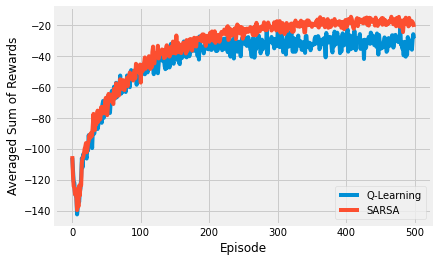

In [ ]:
%matplotlib inline
import matplotlib.pyplot as plt
import pandas as pd

data_files = [("Q-Learning", "q_learning_cliff_rewards.json"),
              ("SARSA", "sarsa_cliff_rewards.json")]

fig, ax = plt.subplots()
for j, (name, data_file) in enumerate(data_files):
    df = pd.read_json(data_file)
    x = range(len(df))
    y = df.sort_index().values
    ax.plot(x,
            y,
            linestyle='solid',
            label=name)
ax.set_xlabel('Episode')
ax.set_ylabel('Averaged Sum of Rewards')
ax.legend(loc='lower right')
plt.show()

### Policy Results

If you're not in a notebook, then you can use `simple_rl` to visualize your policy below. 

In [ ]:
# mdp.visualize_agent(sarsa_agent)

##Double / Delayed Q-learning

### Delayed Q-learning vs. Double Q-learning vs. Q-Learning

Delayed Q-learning and double Q-learning are two extensions to Q-learning that are used throughout RL, so it's worth considering them in a simple form. Delayed Q-learning simply delays any estimate until there is a statistically significant sample of observations. Slowing update with an exponentially weighted moving average is a similar strategy. Double Q-learning includes two Q-tables, in essence two value estimates, to reduce bias.

This notebook builds upon the Q-learning and SARSA notebooks, so I recommend you see them first.



### Experiment

Similar to before, I run the agents on the `CliffWorld` inspired environment. First I setup the the global settings, instantite the environment, then I test the three algorithms and save the data. 

If your not in a notebook you can use the `visualize_policy` function to visualise the policy. `mdp.visualize_policy(ql_agent.policy)` for example.

In [ ]:
import pandas as pd
import numpy as np
from simple_rl.agents import DoubleQAgent, DelayedQAgent, QLearningAgent
from simple_rl.tasks import GridWorldMDP
from simple_rl.run_experiments import run_single_agent_on_mdp

np.random.seed(42)
instances = 10
n_episodes = 1000
alpha = 0.1
epsilon = 0.1

# Setup MDP, Agents.
mdp = GridWorldMDP(
    width=10, height=4, init_loc=(1, 1), goal_locs=[(10, 1)],
    lava_locs=[(x, 1) for x in range(2, 10)], is_lava_terminal=True, gamma=1.0, walls=[], slip_prob=0.0, step_cost=1.0, lava_cost=100.0)

print("Q-Learning")
rewards = np.zeros((n_episodes, instances))
for instance in range(instances):
    ql_agent = QLearningAgent(
        mdp.get_actions(),
        epsilon=epsilon,
        alpha=alpha)
    print("  Instance " + str(instance) + " of " + str(instances) + ".")
    terminal, num_steps, reward = run_single_agent_on_mdp(
        ql_agent, mdp, episodes=n_episodes, steps=100)
    rewards[:, instance] = reward
df = pd.DataFrame(rewards.mean(axis=1))
df.to_json("q_learning_cliff_rewards.json")

print("Double-Q-Learning")
rewards = np.zeros((n_episodes, instances))
for instance in range(instances):
    ql_agent = DoubleQAgent(
        mdp.get_actions(),
        epsilon=epsilon,
        alpha=alpha)
    # mdp.visualize_learning(ql_agent, delay=0.0001)
    print("  Instance " + str(instance) + " of " + str(instances) + ".")
    terminal, num_steps, reward = run_single_agent_on_mdp(
        ql_agent, mdp, episodes=n_episodes, steps=100)
    rewards[:, instance] = reward
df = pd.DataFrame(rewards.mean(axis=1))
df.to_json("double_q_learning_cliff_rewards.json")

print("Delayed-Q-Learning")
rewards = np.zeros((n_episodes, instances))
for instance in range(instances):
    ql_agent = DelayedQAgent(
        mdp.get_actions(),
        epsilon1=alpha)
    # mdp.visualize_learning(ql_agent, delay=0.0001)
    print("  Instance " + str(instance) + " of " + str(instances) + ".")
    terminal, num_steps, reward = run_single_agent_on_mdp(
        ql_agent, mdp, episodes=n_episodes, steps=100)
    rewards[:, instance] = reward
df = pd.DataFrame(rewards.mean(axis=1))
df.to_json("delayed_q_learning_cliff_rewards.json")


Q-Learning
  Instance 0 of 10.
  Instance 1 of 10.
  Instance 2 of 10.
  Instance 3 of 10.
  Instance 4 of 10.
  Instance 5 of 10.
  Instance 6 of 10.
  Instance 7 of 10.
  Instance 8 of 10.
  Instance 9 of 10.
Double-Q-Learning
  Instance 0 of 10.
  Instance 1 of 10.
  Instance 2 of 10.
  Instance 3 of 10.
  Instance 4 of 10.
  Instance 5 of 10.
  Instance 6 of 10.
  Instance 7 of 10.
  Instance 8 of 10.
  Instance 9 of 10.
Delayed-Q-Learning
  Instance 0 of 10.
  Instance 1 of 10.
  Instance 2 of 10.
  Instance 3 of 10.
  Instance 4 of 10.
  Instance 5 of 10.
  Instance 6 of 10.
  Instance 7 of 10.
  Instance 8 of 10.
  Instance 9 of 10.


### Results

Below is the code to visualise the training of the three agents. As usual, there are a maximum of 100 steps, over 200 episodes, averaged over 10 repeats. Feel free to tinker with those settings.

The results show the differences between the three algorithms. In general, double Q-learning tends to be more stable than Q-learning. And delayed Q-learning is more robust against outliers, but can be problematic in environments with larger state/action spaces. I.e. you might have to wait for a long time to get the required number of samples for a particular state-action pair, which will delay further exploration.

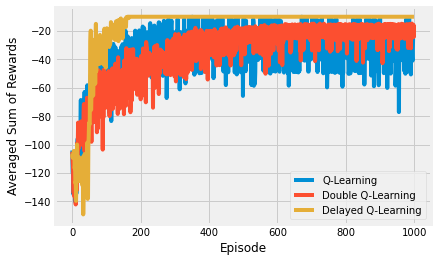

In [ ]:
%matplotlib inline
import matplotlib.pyplot as plt
from matplotlib.ticker import ScalarFormatter, AutoMinorLocator
import json
import os
import numpy as np
import pandas as pd

data_files = [("Q-Learning", "q_learning_cliff_rewards.json"),
              ("Double Q-Learning", "double_q_learning_cliff_rewards.json"),
              ("Delayed Q-Learning", "delayed_q_learning_cliff_rewards.json")]
fig, ax = plt.subplots()
for j, (name, data_file) in enumerate(data_files):
    df = pd.read_json(data_file)
    x = range(len(df))
    y = df.sort_index().values
    ax.plot(x,
            y,
            linestyle='solid',
            label=name)
ax.set_xlabel('Episode')
ax.set_ylabel('Averaged Sum of Rewards')
ax.legend(loc='lower right')
plt.show()

##N-step Algorithms

Another fundamental algorithm is the use of n-Step returns, rather than single step returns in the basic Q-learning or SARSA implementations. Rather than just looking one step into the future and estimating the return, you can look several steps. This is implemented in a backwards fashion, where you should travel first then updates the states you have visited. But it works really well.

This notebook builds upon the Q-learning and SARSA sections, so we recommend going through them first.

### n-Step SARSA Agent

`simple_rl` doesn't come with an n-Step SARSA implementation so I must create one first. The code is below. Again, most of the complexity is due to the library abstractions. The most important code is in the `update` function.

In [6]:
import numpy as np
import sys
from collections import defaultdict
from simple_rl.agents import Agent, QLearningAgent


class nStepSARSAAgent(QLearningAgent):
    def __init__(self, actions, n, name="n-Step SARSA",
                 alpha=0.1, gamma=0.99, epsilon=0.1, explore="uniform", anneal=False):
        self.T = sys.maxsize
        self.stored_rewards = []
        self.stored_states = []
        self.stored_actions = []
        self.n = n
        QLearningAgent.__init__(
            self,
            actions=list(actions),
            name=name,
            alpha=alpha,
            gamma=gamma,
            epsilon=epsilon,
            explore=explore,
            anneal=anneal)

    def policy(self, state):
        return self.get_max_q_action(state)

    def act(self, state, reward, learning=True):
        action = self.update(reward, state)
        return action

    def update(self, rt1, st1):
        if len(self.stored_states) == 0:
            action = self.epsilon_greedy_q_policy(st1)
            self.stored_actions.append(action)
            self.stored_states.append(st1)
            self.stored_rewards.append(rt1)
            return action

        if self.step_number < self.T:
            # Observe and store the next reward R_{t+1} and next state
            # S_{t+1}
            self.stored_rewards.append(rt1)
            self.stored_states.append(st1)

            # if s_{t+1} terminal
            if st1.is_terminal():
                self.T = self.step_number + 1
            else:
                action = self.epsilon_greedy_q_policy(st1)
                self.stored_actions.append(action)

        self.tau = self.step_number - self.n + 1
        if self.tau >= 0:
            # G = sum(\gamma * R)
            start_index = self.tau + 1
            end_index = min(self.tau + self.n, self.T)
            G = 0
            for i in range(
                    start_index, end_index + 1):  # Because range is exclusive
                G += self.gamma**(i - self.tau - 1) * self.stored_rewards[i]

            if self.tau + self.n < self.T:
                G += self.gamma**self.n * \
                    self.q_func[self.stored_states[(
                        self.tau + self.n)]][self.stored_actions[(self.tau + self.n)]]
            s_tau = self.stored_states[self.tau]
            a_tau = self.stored_actions[self.tau]
            self.q_func[s_tau][a_tau] += self.alpha * \
                (G - self.q_func[s_tau][a_tau])
        # If at end repeat until tau == T - 1
        self.step_number += 1
        if self.step_number >= self.T and self.tau < self.T - 1:
            self.update(None, None)
        return self.stored_actions[-1]

    def end_of_episode(self):
        self.prev_state = None
        self.prev_action = None
        self.episode_number += 1
        self.T = sys.maxsize
        self.step_number = 0
        self.stored_rewards = []
        self.stored_states = []
        self.stored_actions = []

    def reset(self):
        self.prev_state = None
        self.prev_action = None
        self.step_number = 0


### Experiment

Similar to before, I run the agents on the `CliffWorld` inspired environment. First I setup the the global settings, instantite the environment, then I test the three algorithms and save the data. 

If your not in a notebook you can use the `visualize_policy` function to visualise the policy. `mdp.visualize_policy(ql_agent.policy)` for example.

In [ ]:
import pandas as pd
import numpy as np
from simple_rl.agents import DoubleQAgent, DelayedQAgent
from simple_rl.tasks import GridWorldMDP
from simple_rl.run_experiments import run_single_agent_on_mdp
from simple_rl.abstraction import AbstractionWrapper
from simple_rl.utils import chart_utils

np.random.seed(42)
visualise_double_q_learning = False
visualise_delayed_q_learning = False

instances = 10
n_episodes = 500
alpha = 0.1
epsilon = 0.1

# Setup MDP, Agents.
mdp = GridWorldMDP(
    width=10, height=4, init_loc=(1, 1), goal_locs=[(10, 1)],
    lava_locs=[(x, 1) for x in range(2, 10)], is_lava_terminal=True, gamma=1.0, walls=[], slip_prob=0.0, step_cost=1.0, lava_cost=100.0)

print("SARSA")
rewards = np.zeros((n_episodes, instances))
for instance in range(instances):
    ql_agent = nStepSARSAAgent(
        mdp.get_actions(),
        n=1,
        epsilon=epsilon,
        alpha=alpha)
    print("  Instance " + str(instance) + " of " + str(instances) + ".")
    terminal, num_steps, reward = run_single_agent_on_mdp(
        ql_agent, mdp, episodes=n_episodes, steps=100)
    rewards[:, instance] = reward
df = pd.DataFrame(rewards.mean(axis=1))
df.to_json("sarsa_cliff_rewards.json")

print("2-Step SARSA")
rewards = np.zeros((n_episodes, instances))
for instance in range(instances):
    ql_agent = nStepSARSAAgent(
        mdp.get_actions(),
        n=2,
        epsilon=epsilon,
        alpha=alpha)
    print("  Instance " + str(instance) + " of " + str(instances) + ".")
    terminal, num_steps, reward = run_single_agent_on_mdp(
        ql_agent, mdp, episodes=n_episodes, steps=100)
    rewards[:, instance] = reward
df = pd.DataFrame(rewards.mean(axis=1))
df.to_json("2_step_sarsa_cliff_rewards.json")

print("4-Step SARSA")
rewards = np.zeros((n_episodes, instances))
for instance in range(instances):
    ql_agent = nStepSARSAAgent(
        mdp.get_actions(),
        n=4,
        epsilon=epsilon,
        alpha=alpha)
    print("  Instance " + str(instance) + " of " + str(instances) + ".")
    terminal, num_steps, reward = run_single_agent_on_mdp(
        ql_agent, mdp, episodes=n_episodes, steps=100)
    rewards[:, instance] = reward
df = pd.DataFrame(rewards.mean(axis=1))
df.to_json("4_step_sarsa_cliff_rewards.json")

SARSA
  Instance 0 of 10.
  Instance 1 of 10.
  Instance 2 of 10.
  Instance 3 of 10.
  Instance 4 of 10.
  Instance 5 of 10.
  Instance 6 of 10.
  Instance 7 of 10.
  Instance 8 of 10.
  Instance 9 of 10.
2-Step SARSA
  Instance 0 of 10.
  Instance 1 of 10.
  Instance 2 of 10.
  Instance 3 of 10.
  Instance 4 of 10.
  Instance 5 of 10.
  Instance 6 of 10.
  Instance 7 of 10.
  Instance 8 of 10.
  Instance 9 of 10.
4-Step SARSA
  Instance 0 of 10.
  Instance 1 of 10.
  Instance 2 of 10.
  Instance 3 of 10.
  Instance 4 of 10.
  Instance 5 of 10.
  Instance 6 of 10.
  Instance 7 of 10.
  Instance 8 of 10.
  Instance 9 of 10.


### Results

Below is the code to visualise the training of the three agents. There are a maximum of 100 steps, over 500 episodes, averaged over 10 repeats. Feel free to tinker with those settings.

The results show the differences between the three algorithms. In general, a higher value of `n` learns more quickly, with diminishing returns.

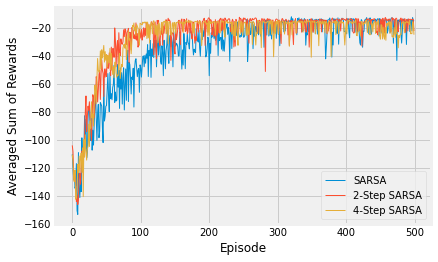

In [ ]:
%matplotlib inline
import matplotlib.pyplot as plt
from matplotlib.ticker import ScalarFormatter, AutoMinorLocator
import json
import os
import numpy as np
import pandas as pd

data_files = [("SARSA", "sarsa_cliff_rewards.json"),
              ("2-Step SARSA", "2_step_sarsa_cliff_rewards.json"),
              ("4-Step SARSA", "4_step_sarsa_cliff_rewards.json")]
fig, ax = plt.subplots()
for j, (name, data_file) in enumerate(data_files):
    df = pd.read_json(data_file)
    x = range(len(df))
    y = df.sort_index().values
    ax.plot(x,
            y,
            linestyle='solid',
            linewidth=1,
            label=name)
ax.set_xlabel('Episode')
ax.set_ylabel('Averaged Sum of Rewards')
ax.legend(loc='lower right')
plt.show()

## Eligibility Traces

Eligibility traces implement n-Step methods on a sliding scale. They smoothly vary the amount that the return is projected, from a single step up to far into the future. They are implemented with "tracers" which remember where the agent has been in the past and update them accordingly. They are intuitive, especially in a discrete setting.



### Eligibility Traces SARSA Agent

`simple_rl` doesn't come with an Eligibility Traces SARSA implementation so I must create one first. The code is below. Again, most of the complexity is due to the library abstractions. The most important code is in the `update` function.

In [ ]:
import numpy as np
import sys
from collections import defaultdict
from simple_rl.agents import Agent, QLearningAgent


class lambdaSARSAAgent(QLearningAgent):
    def __init__(self, actions, name="lambda SARSA",
                 alpha=0.5, lam=0.5, gamma=1.0, epsilon=0.1, explore="uniform",
                 anneal=False, replacement_method="accumulate"):
        self.lam = lam
        self.eligibility = defaultdict(lambda: defaultdict(lambda: 0))
        self.replacement_method = replacement_method
        QLearningAgent.__init__(
            self,
            actions=list(actions),
            name=name,
            alpha=alpha,
            gamma=gamma,
            epsilon=epsilon,
            explore=explore,
            anneal=anneal)

    def act(self, new_state, reward, learning=True):
        next_action = self.epsilon_greedy_q_policy(new_state)
        if self.prev_state is None:
            self.prev_state = new_state
            self.prev_action = next_action
            return next_action
        self.update(
            self.prev_state,
            self.prev_action,
            reward,
            new_state,
            next_action)
        self.prev_state = new_state
        self.prev_action = next_action
        return next_action

    def update(self, state, action, reward, next_state, next_action):
        td_error = reward + self.gamma * \
            self.q_func[next_state][next_action] - self.q_func[state][action]
        if self.replacement_method == "accumulate":
            self.eligibility[state][action] += 1
        elif self.replacement_method == "replace":
            self.eligibility[state][action] = 1
        for s in self.eligibility.keys():
            for a in self.eligibility[s].keys():
                self.q_func[s][a] += self.alpha * \
                    td_error * self.eligibility[s][a]
                self.eligibility[s][a] *= self.gamma * self.lam

    def end_of_episode(self):
        self.eligibility = defaultdict(lambda: defaultdict(lambda: 0))
        QLearningAgent.end_of_episode(self)


class lambdaWatkinsSARSAAgent(lambdaSARSAAgent):
    def epsilon_greedy_q_policy(self, state):
        # Policy: Epsilon of the time explore, otherwise, greedyQ.
        if np.random.random() > self.epsilon:
            # Exploit.
            action = self.get_max_q_action(state)
        else:
            # Explore
            action = np.random.choice(self.actions)
            # Reset eligibility trace
            self.eligibility = defaultdict(lambda: defaultdict(lambda: 0))
        return action

### Experiment

Similar to before, I run the agents on the `CliffWorld` inspired environment. First I setup the the global settings, instantite the environment, then I test the three algorithms and save the data. 

If your not in a notebook you can use the `visualize_policy` function to visualise the policy. `mdp.visualize_policy(ql_agent.policy)` for example.

In [ ]:
import pandas as pd
import numpy as np

from simple_rl.agents import DoubleQAgent, DelayedQAgent
from simple_rl.tasks import GridWorldMDP
from simple_rl.run_experiments import run_single_agent_on_mdp

np.random.seed(42)
instances = 10
n_episodes = 500
alpha = 0.1
epsilon = 0.1

# Setup MDP, Agents.
mdp = GridWorldMDP(
    width=10, height=4, init_loc=(1, 1), goal_locs=[(10, 1)],
    lava_locs=[(x, 1) for x in range(2, 10)], is_lava_terminal=True, gamma=1.0, walls=[], slip_prob=0.0, step_cost=1.0, lava_cost=100.0)

print("lambda SARSA")
rewards = np.zeros((n_episodes, instances))
for instance in range(instances):
    ql_agent = lambdaSARSAAgent(
        mdp.get_actions(),
        epsilon=epsilon,
        alpha=alpha,
        lam=0.5)
    print("  Instance " + str(instance) + " of " + str(instances) + ".")
    terminal, num_steps, reward = run_single_agent_on_mdp(
        ql_agent, mdp, episodes=n_episodes, steps=100)
    rewards[:, instance] = reward
df = pd.DataFrame(rewards.mean(axis=1))
df.to_json("lambda_sarsa_0.5_cliff_rewards.json")

print("lambda SARSA")
rewards = np.zeros((n_episodes, instances))
for instance in range(instances):
    ql_agent = lambdaSARSAAgent(
        mdp.get_actions(),
        epsilon=epsilon,
        alpha=alpha,
        lam=0.8)
    print("  Instance " + str(instance) + " of " + str(instances) + ".")
    terminal, num_steps, reward = run_single_agent_on_mdp(
        ql_agent, mdp, episodes=n_episodes, steps=100)
    rewards[:, instance] = reward
df = pd.DataFrame(rewards.mean(axis=1))
df.to_json("lambda_sarsa_0.8_cliff_rewards.json")

lambda SARSA
  Instance 0 of 10.
  Instance 1 of 10.
  Instance 2 of 10.
  Instance 3 of 10.
  Instance 4 of 10.
  Instance 5 of 10.
  Instance 6 of 10.
  Instance 7 of 10.
  Instance 8 of 10.
  Instance 9 of 10.
lambda SARSA
  Instance 0 of 10.
  Instance 1 of 10.
  Instance 2 of 10.
  Instance 3 of 10.
  Instance 4 of 10.
  Instance 5 of 10.
  Instance 6 of 10.
  Instance 7 of 10.
  Instance 8 of 10.
  Instance 9 of 10.


### Results

Below is the code to visualise the training of the three agents. There are a maximum of 100 steps, over 500 episodes, averaged over 10 repeats. Feel free to tinker with those settings.

The results show the differences between two values for the lambda hyperparameter. Feel free to alter the value to see what happens. Also compare these results to the experiments with SARSA and n-Step agents. Try copying the code from that notebook into here and plotting the result.

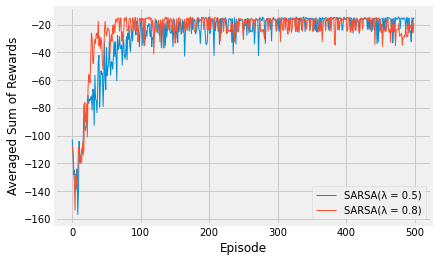

In [ ]:
%matplotlib inline
import matplotlib.pyplot as plt
from matplotlib.ticker import ScalarFormatter, AutoMinorLocator
import json
import os
import numpy as np
import pandas as pd

data_files = [("SARSA(λ = 0.5)", "lambda_sarsa_0.5_cliff_rewards.json"),
              ("SARSA(λ = 0.8)", "lambda_sarsa_0.8_cliff_rewards.json"),
              ]
fig, ax = plt.subplots()
for j, (name, data_file) in enumerate(data_files):
    df = pd.read_json(data_file)
    x = range(len(df))
    y = df.sort_index().values
    ax.plot(x,
            y,
            linestyle='solid',
            linewidth=1,
            label=name)
ax.set_xlabel('Episode')
ax.set_ylabel('Averaged Sum of Rewards')
ax.legend(loc='lower right')
plt.show()

# Policy Gradient Methods

## REINFORCE: Monte Carlo Policy Gradient Methods

Policy gradient methods work by first choosing actions directly from a parameterized model, then secondly updating the weights of the model to nudge the next predictions towards higher expected returns.

REINFORCE achieves this by collecting a full trajectory then updating the policy weights in a Monte Carlo-style.

To demonstrate this I will implement REINFORCE in `simple_rl` using a logistic policy model.



### Setup and the Environment

For this experiment I will use the `cartpole` environment. Then I set the seeds to produce consistent results.

In [ ]:
import gym
import random
import numpy as np
from simple_rl.tasks import GymMDP


# Gym MDP
gym_mdp = GymMDP(env_name="CartPole-v1", render=False)
num_feats = gym_mdp.get_num_state_feats()

In [ ]:
GLOBAL_SEED = 0
random.seed(GLOBAL_SEED)
np.random.seed(GLOBAL_SEED)
gym_mdp.env.seed(GLOBAL_SEED)

[0]

### REINFORCE Agent

The code below defines the REINFORCE agent. The key to this implementation is that I have manually differentiated the logistic function so the gradient can be calculated directly. In reality you would probably use an automatic differentiation framework, or use a framework that provides the gradients for you.

Once you have the gradient, then all you need to do is use the policy gradient update rule to nudge the parameters towards areas of higher return.

In [ ]:
from simple_rl.agents import PolicyGradientAgent

class LogisticPolicyAgent(PolicyGradientAgent):
    def __init__(self, actions, num_feats):
        self.α = 0.01
        self.γ = 0.99
        self.num_feats = num_feats
        PolicyGradientAgent.__init__(
            self, name="logistic_policy_gradient", actions=actions
        )
        self.reset()

    @staticmethod
    def logistic(x):
        return 1 / (1 + np.exp(-x))

    @staticmethod
    def π(θ, s):
        π = LogisticPolicyAgent.logistic(np.dot(θ.T, s))
        return np.array([π, 1 - π])

    @staticmethod
    def Δ(θ, s):
        π = LogisticPolicyAgent.logistic(np.dot(θ.T, s))
        return np.array([s - s * π, -s * π])

    def act(self, state, reward):
        if self.previous_pair is not None:
            self.episode_history.append(Step(self.previous_pair, reward))
        π = LogisticPolicyAgent.π(self.θ, state)
        action = np.random.choice((0, 1), p=π)
        self.previous_pair = Pair(state.data, action)
        return action

    def reset(self):
        self.θ = np.zeros(self.num_feats)
        self.end_of_episode()
        PolicyGradientAgent.reset(self)

    def end_of_episode(self):
        T = len(getattr(self, "episode_history", []))
        G = 0
        grad_buf = []
        for t in reversed(range(T)):
            G = G * self.γ + self.episode_history[t].reward
            grad = LogisticPolicyAgent.Δ(self.θ, self.episode_history[t].pair.state)[
                self.episode_history[t].pair.action
            ]
            self.θ += self.α * np.power(self.γ, t) * grad * G
            grad_buf.append(np.power(self.γ, t) * grad * G)
        reinforce_gradient_buffer.append(
            [np.mean(np.abs(grad_buf)), np.std(grad_buf)])
        self.episode_history = []
        self.previous_pair = None
        PolicyGradientAgent.end_of_episode(self)


### Training the Agent

Now I'm ready to run the experiment to train the agent. You might want to play around with the `instances` parameter, which controls the number of repeats to average over.

In [ ]:
from simple_rl.run_experiments import run_agents_on_mdp
from collections import namedtuple

Step = namedtuple("Step", ["pair", "reward"])
Pair = namedtuple("Pair", ["state", "action"])

reinforce_gradient_buffer = []
REINFORCE = LogisticPolicyAgent(gym_mdp.get_actions(), num_feats)
run_agents_on_mdp(
    [REINFORCE],
    gym_mdp,
    instances=2,
    episodes=500,
    steps=1000,
    open_plot=False,
    verbose=False,
    cumulative_plot=False,
)
np.savetxt("gradient_REINFORCE.txt", np.array(reinforce_gradient_buffer))

Running experiment: 
(MDP)
	gym-CartPole-v1
(Agents)
	logistic_policy_gradient,0
(Params)
	instances : 2
	episodes : 500
	steps : 1000
	track_disc_reward : False

logistic_policy_gradient is learning.
  Instance 1 of 2.
/opt/conda/lib/python3.7/site-packages/numpy/core/fromnumeric.py:3335: RuntimeWarning: Mean of empty slice.
  out=out, **kwargs)
/opt/conda/lib/python3.7/site-packages/numpy/core/_methods.py:161: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
/opt/conda/lib/python3.7/site-packages/numpy/core/_methods.py:217: RuntimeWarning: Degrees of freedom <= 0 for slice
  keepdims=keepdims)
/opt/conda/lib/python3.7/site-packages/numpy/core/_methods.py:186: RuntimeWarning: invalid value encountered in true_divide
  arrmean, rcount, out=arrmean, casting='unsafe', subok=False)
/opt/conda/lib/python3.7/site-packages/numpy/core/_methods.py:209: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount

### Plotting the Results

The following will read from the saved results.

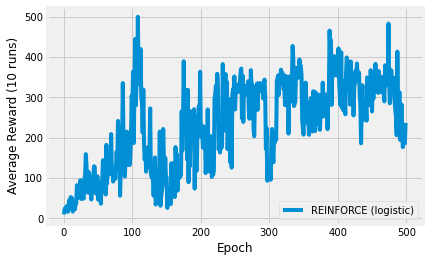

In [ ]:
%matplotlib inline
import matplotlib
import matplotlib.pyplot as plt
from matplotlib.ticker import ScalarFormatter, AutoMinorLocator
import matplotlib as mpl
import json
import os
import numpy as np
import pandas as pd
from pathlib import Path
from glob import glob
import subprocess

def plot(experiment_name, data_files, cutoff=None):
    fig, ax = plt.subplots(nrows=1, ncols=1)
    for j, (name, data_file) in enumerate(data_files):
        df = pd.read_csv(data_file, header=None).transpose()
        if cutoff:
            df = df.truncate(after=cutoff)
        x = df.index.values
        y = df.values
        if len(y.shape) > 1:
            y = y.mean(axis=1)
        ax.plot(x,
                y,
                label=name)

    ax.set_xlabel('Epoch')
    ax.set_ylabel('Average Reward (10 runs)')
    ax.legend(loc='lower right')
    plt.show()

data_files = [
    ("REINFORCE (logistic)", "results/gym-CartPole-v1/logistic_policy_gradient.csv"),
]
plot("reinforce_reward_plot", data_files, cutoff=500)

### Discussion

The image above shows the result of plotting the average reward over 500 episodes. The specific curve will depend on your seed and the number of repetitions to average over.

The thing to take away from this experiment is the sheer simplicity of what is going on here. I have defined a very simple model and manually derived the gradient. The environment has 4 continuous features so I need a 4-parameter model. To find an optimal policy, you just need to nudge the gradients towards higher returns. That's it!

This means that policy gradient methods work really well with continuous state spaces, where value-based methods would struggle, due to the required discretisation.



## REINFORCE with Baseline Policy Gradient Algorithm

The various baseline algorithms attempt to stabilise learning by subtracting the average expected return from the action-values, which leads to stable action-values. Contrast this to vanilla policy gradient or Q-learning algorithms that continuously increment the Q-value, which leads to situations where a minor incremental update to one of the actions causes vast changes in the policy.

In this workshop I will build upon the previous and also show you how to visualise the discounted reward over various states. I won't talk about the elements discussed in previous tuorials.



### Setup and Previous Agents

In [ ]:
import gym
import random
import numpy as np
from simple_rl.tasks import GymMDP


# Gym MDP
gym_mdp = GymMDP(env_name="CartPole-v1", render=False)
num_feats = gym_mdp.get_num_state_feats()

GLOBAL_SEED = 0
random.seed(GLOBAL_SEED)
np.random.seed(GLOBAL_SEED)
gym_mdp.env.seed(GLOBAL_SEED)

from simple_rl.agents import PolicyGradientAgent

class LogisticPolicyAgent(PolicyGradientAgent):
    def __init__(self, actions, num_feats):
        self.α = 0.01
        self.γ = 0.99
        self.num_feats = num_feats
        PolicyGradientAgent.__init__(
            self, name="logistic_policy_gradient", actions=actions
        )
        self.reset()

    @staticmethod
    def logistic(x):
        return 1 / (1 + np.exp(-x))

    @staticmethod
    def π(θ, s):
        π = LogisticPolicyAgent.logistic(np.dot(θ.T, s))
        return np.array([π, 1 - π])

    @staticmethod
    def Δ(θ, s):
        π = LogisticPolicyAgent.logistic(np.dot(θ.T, s))
        return np.array([s - s * π, -s * π])

    def act(self, state, reward):
        if self.previous_pair is not None:
            self.episode_history.append(Step(self.previous_pair, reward))
        π = LogisticPolicyAgent.π(self.θ, state)
        action = np.random.choice((0, 1), p=π)
        self.previous_pair = Pair(state.data, action)
        return action

    def reset(self):
        self.θ = np.zeros(self.num_feats)
        self.end_of_episode()
        PolicyGradientAgent.reset(self)

    def end_of_episode(self):
        T = len(getattr(self, "episode_history", []))
        G = 0
        grad_buf = []
        for t in reversed(range(T)):
            G = G * self.γ + self.episode_history[t].reward
            grad = LogisticPolicyAgent.Δ(self.θ, self.episode_history[t].pair.state)[
                self.episode_history[t].pair.action
            ]
            self.θ += self.α * np.power(self.γ, t) * grad * G
            grad_buf.append(np.power(self.γ, t) * grad * G)
        reinforce_gradient_buffer.append(
            [np.mean(np.abs(grad_buf)), np.std(grad_buf)])
        self.episode_history = []
        self.previous_pair = None
        PolicyGradientAgent.end_of_episode(self)


### Reinforce with Baseline Agent

The new agent is basically the same as the standard REINFORCE agent, except for the addition of a weighted moving average to estimate the baseline, which is subtracted from the expected return.

In [ ]:

class LogisticPolicyAgentWithBaseline(PolicyGradientAgent):
    def __init__(self, actions, num_feats, α_θ=0.01, prefix=""):
        self.α_θ = α_θ
        self.α_w = 0.1
        self.γ = 0.99
        self.num_feats = num_feats
        PolicyGradientAgent.__init__(
            self, name=prefix + "logistic_policy_gradient_with_baseline", actions=actions
        )
        self.reset()

    def act(self, state, reward):
        if self.previous_pair is not None:
            self.episode_history.append(Step(self.previous_pair, reward))
        π = LogisticPolicyAgent.π(self.θ, state)
        action = np.random.choice((0, 1), p=π)
        self.previous_pair = Pair(state.data, action)
        self.t += 1
        return action

    def reset(self):
        self.θ = np.zeros(self.num_feats)
        self.w = 0
        self.end_of_episode()
        PolicyGradientAgent.reset(self)

    def end_of_episode(self):
        self.t = 0
        T = len(getattr(self, "episode_history", []))
        G = 0
        grad_buf = []
        for t in reversed(range(T)):
            G = G * self.γ + self.episode_history[t].reward
            δ = G - self.w
            global_buffer.append(
                np.concatenate(
                    [self.episode_history[t].pair.state, np.array([G])])
            )
            self.w += self.α_w * δ
            Δπ = LogisticPolicyAgent.Δ(self.θ, self.episode_history[t].pair.state)[
                self.episode_history[t].pair.action
            ]
            self.θ += self.α_θ * np.power(self.γ, t) * δ * Δπ
            grad_buf.append(np.power(self.γ, t) * δ * Δπ)
        baseline_gradient_buffer.append(
            [np.mean(np.abs(grad_buf)), np.std(grad_buf)])
        self.episode_history = []
        self.previous_pair = None
        PolicyGradientAgent.end_of_episode(self)

### Training the Agent

Now I'm ready to run the experiment to train the agent. You might want to play around with the `instances` parameter, which controls the number of repeats to average over.

In [ ]:
from simple_rl.run_experiments import run_agents_on_mdp
from collections import namedtuple

Step = namedtuple("Step", ["pair", "reward"])
Pair = namedtuple("Pair", ["state", "action"])

reinforce_gradient_buffer = []
REINFORCE = LogisticPolicyAgent(gym_mdp.get_actions(), num_feats)
run_agents_on_mdp(
    [REINFORCE],
    gym_mdp,
    instances=2,
    episodes=500,
    steps=1000,
    open_plot=False,
    verbose=False,
    cumulative_plot=False,
)
np.savetxt("gradient_REINFORCE.txt", np.array(reinforce_gradient_buffer))

global_buffer = []
baseline_gradient_buffer = []
REINFORCE_baseline = LogisticPolicyAgentWithBaseline(
    gym_mdp.get_actions(), num_feats
)
run_agents_on_mdp(
    [REINFORCE_baseline],
    gym_mdp,
    instances=2,
    episodes=500,
    steps=1000,
    open_plot=False,
    verbose=False,
    cumulative_plot=False,
)
np.savetxt("state_reward_REINFORCE_baseline.txt", np.array(global_buffer))
np.savetxt("gradient_REINFORCE_baseline.txt",
            np.array(baseline_gradient_buffer))

Running experiment: 
(MDP)
	gym-CartPole-v1
(Agents)
	logistic_policy_gradient,0
(Params)
	instances : 2
	episodes : 500
	steps : 1000
	track_disc_reward : False

logistic_policy_gradient is learning.
  Instance 1 of 2.
/opt/conda/lib/python3.7/site-packages/numpy/core/fromnumeric.py:3335: RuntimeWarning: Mean of empty slice.
  out=out, **kwargs)
/opt/conda/lib/python3.7/site-packages/numpy/core/_methods.py:161: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
/opt/conda/lib/python3.7/site-packages/numpy/core/_methods.py:217: RuntimeWarning: Degrees of freedom <= 0 for slice
  keepdims=keepdims)
/opt/conda/lib/python3.7/site-packages/numpy/core/_methods.py:186: RuntimeWarning: invalid value encountered in true_divide
  arrmean, rcount, out=arrmean, casting='unsafe', subok=False)
/opt/conda/lib/python3.7/site-packages/numpy/core/_methods.py:209: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount

### Plotting the Episode Return

The baseline algorithm needs the ability to predict the return for a given state. This means you need a representative model to be able to predict that. I tried a few things, but quickly realised that the data are remarkably complex. The code below takes some trajectories, runs principal component analysis and plots the result. 

Remember that there are four features, so the space is more complex than this. But you can quickly see that the data is strange. It's shaped like a triangle. This is primarily because the next return depends on the previous; it's cumulative. Therefore, I thought that I could use a simple online rolling average of previously observed rewards.

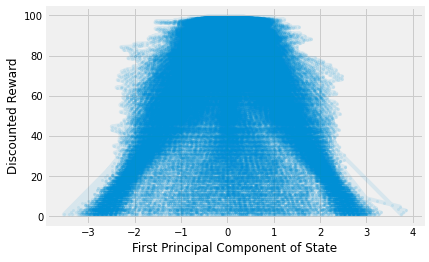

In [ ]:
%matplotlib inline
from sklearn.decomposition import PCA
import matplotlib.pyplot as plt

data = np.loadtxt("state_reward_REINFORCE_baseline.txt")

x = data[:, 0:4]
pca = PCA(n_components=1)
x = pca.fit_transform(x)
y = data[:, 4]

fig, ax = plt.subplots(nrows=1, ncols=1)
plt.plot(x, y, marker='.', alpha=0.1, markeredgewidth=0.0)
ax.set_xlabel('First Principal Component of State')
ax.set_ylabel('Discounted Reward')
plt.show()

### Plotting the Results

The following will read from the saved results.

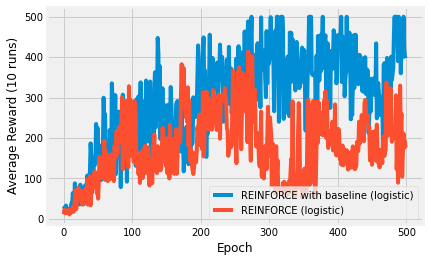

In [ ]:
%matplotlib inline
import matplotlib
import matplotlib.pyplot as plt
from matplotlib.ticker import ScalarFormatter, AutoMinorLocator
import matplotlib as mpl
import json
import os
import numpy as np
import pandas as pd
from pathlib import Path
from glob import glob
import subprocess

def plot(experiment_name, data_files, cutoff=None):
    fig, ax = plt.subplots(nrows=1, ncols=1)
    for j, (name, data_file) in enumerate(data_files):
        df = pd.read_csv(data_file, header=None).transpose()
        if cutoff:
            df = df.truncate(after=cutoff)
        x = df.index.values
        y = df.values
        if len(y.shape) > 1:
            y = y.mean(axis=1)
        ax.plot(x,
                y,
                label=name)

    ax.set_xlabel('Epoch')
    ax.set_ylabel('Average Reward (10 runs)')
    ax.legend(loc='lower right')
    plt.show()

data_files = [
    ("REINFORCE with baseline (logistic)", "results/gym-CartPole-v1/logistic_policy_gradient_with_baseline.csv"),
    ("REINFORCE (logistic)", "results/gym-CartPole-v1/logistic_policy_gradient.csv"),
]
plot("reinforce_reward_plot", data_files, cutoff=500)

### Discussion

You can see that the baseline algorithm performs better, just, than the basic REINFORCE algorithm. If you performed more repeats, this would become clearer.

I encourage you to try this yourself with a single repeat. You should be able to observe the baseline algorithm increasing in performance more consistently than the standard algorithm, which seems to repeatedly drop back to zero. This is because of subtle, but catastrophic updates to the Q-values. Sometimes they nudge the policies towards bad policies.



## One-Step Actor-Critic Algorithm

Monte Carlo implementations like those of REINFORCE and baseline do not bootstrap, so they are slow to learn. Temporal difference solutions do bootstrap and can be incorporated into policy gradient algorithms in the same way that n-Step algorithms use it. The addition of n-Step expected returns to the REINFORCE with baseline algorithm yeilds an n-Step actor-critic.

I'm not a huge fan of the actor-critic terminology, because it obfuscates the fact that it is simply REINFORCE with a baseline, where the expected return is implemented as n-Step returns. That's it.

I'll implement that below and you'll be suprised how similar the algorithm is. However, this time I'm going to use tile coding to encode the continous state space, to get a better baseline estimate.



### Setup and Previous Agents

This is the previous REINFORCE with baseline implementation. Take a look at the [previous notebook]({{< ref "learn/policy_gradients/reinforce_baseline/index.md" >}}) if you are interested.

In [ ]:
import gym
import random
import numpy as np
from simple_rl.tasks import GymMDP


# Gym MDP
gym_mdp = GymMDP(env_name="CartPole-v1", render=False)
num_feats = gym_mdp.get_num_state_feats()

GLOBAL_SEED = 0
random.seed(GLOBAL_SEED)
np.random.seed(GLOBAL_SEED)
gym_mdp.env.seed(GLOBAL_SEED)

from simple_rl.agents import PolicyGradientAgent

class LogisticPolicyAgent(PolicyGradientAgent):
    def __init__(self, actions, num_feats):
        self.α = 0.01
        self.γ = 0.99
        self.num_feats = num_feats
        PolicyGradientAgent.__init__(
            self, name="logistic_policy_gradient", actions=actions
        )
        self.reset()

    @staticmethod
    def logistic(x):
        return 1 / (1 + np.exp(-x))

    @staticmethod
    def π(θ, s):
        π = LogisticPolicyAgent.logistic(np.dot(θ.T, s))
        return np.array([π, 1 - π])

    @staticmethod
    def Δ(θ, s):
        π = LogisticPolicyAgent.logistic(np.dot(θ.T, s))
        return np.array([s - s * π, -s * π])

    def act(self, state, reward):
        if self.previous_pair is not None:
            self.episode_history.append(Step(self.previous_pair, reward))
        π = LogisticPolicyAgent.π(self.θ, state)
        action = np.random.choice((0, 1), p=π)
        self.previous_pair = Pair(state.data, action)
        return action

    def reset(self):
        self.θ = np.zeros(self.num_feats)
        self.end_of_episode()
        PolicyGradientAgent.reset(self)

    def end_of_episode(self):
        T = len(getattr(self, "episode_history", []))
        G = 0
        grad_buf = []
        for t in reversed(range(T)):
            G = G * self.γ + self.episode_history[t].reward
            grad = LogisticPolicyAgent.Δ(self.θ, self.episode_history[t].pair.state)[
                self.episode_history[t].pair.action
            ]
            self.θ += self.α * np.power(self.γ, t) * grad * G
            grad_buf.append(np.power(self.γ, t) * grad * G)
        reinforce_gradient_buffer.append(
            [np.mean(np.abs(grad_buf)), np.std(grad_buf)])
        self.episode_history = []
        self.previous_pair = None
        PolicyGradientAgent.end_of_episode(self)
        
class LogisticPolicyAgentWithBaseline(PolicyGradientAgent):
    def __init__(self, actions, num_feats, α_θ=0.01, prefix=""):
        self.α_θ = α_θ
        self.α_w = 0.1
        self.γ = 0.99
        self.num_feats = num_feats
        PolicyGradientAgent.__init__(
            self, name=prefix + "logistic_policy_gradient_with_baseline", actions=actions
        )
        self.reset()

    def act(self, state, reward):
        if self.previous_pair is not None:
            self.episode_history.append(Step(self.previous_pair, reward))
        π = LogisticPolicyAgent.π(self.θ, state)
        action = np.random.choice((0, 1), p=π)
        self.previous_pair = Pair(state.data, action)
        self.t += 1
        return action

    def reset(self):
        self.θ = np.zeros(self.num_feats)
        self.w = 0
        self.end_of_episode()
        PolicyGradientAgent.reset(self)

    def end_of_episode(self):
        self.t = 0
        T = len(getattr(self, "episode_history", []))
        G = 0
        grad_buf = []
        for t in reversed(range(T)):
            G = G * self.γ + self.episode_history[t].reward
            δ = G - self.w
            global_buffer.append(
                np.concatenate(
                    [self.episode_history[t].pair.state, np.array([G])])
            )
            self.w += self.α_w * δ
            Δπ = LogisticPolicyAgent.Δ(self.θ, self.episode_history[t].pair.state)[
                self.episode_history[t].pair.action
            ]
            self.θ += self.α_θ * np.power(self.γ, t) * δ * Δπ
            grad_buf.append(np.power(self.γ, t) * δ * Δπ)
        baseline_gradient_buffer.append(
            [np.mean(np.abs(grad_buf)), np.std(grad_buf)])
        self.episode_history = []
        self.previous_pair = None
        PolicyGradientAgent.end_of_episode(self)

### Tile Coding

Tile coding attemps to split the feature space into discrete bins, where you set the bin to 1 if the value is contained within that bin. If you overlap the bin boundaries, you end up with quite an accurate representation of a continuous feature in discrete form.

TODO: In depth article example about tile coding.

In [ ]:
# Taken from https://github.com/MeepMoop/tilecoding
class TileCoder:
    def __init__(
        self,
        tiles_per_dim,
        value_limits,
        tilings,
        offset=lambda n: 2 * np.arange(n) + 1,
    ):
        tiling_dims = np.array(np.ceil(tiles_per_dim), dtype=np.int) + 1
        self._offsets = (
            offset(len(tiles_per_dim))
            * np.repeat([np.arange(tilings)], len(tiles_per_dim), 0).T
            / float(tilings)
            % 1
        )
        self._limits = np.array(value_limits)
        self._norm_dims = np.array(tiles_per_dim) / (
            self._limits[:, 1] - self._limits[:, 0]
        )
        self._tile_base_ind = np.prod(tiling_dims) * np.arange(tilings)
        self._hash_vec = np.array(
            [np.prod(tiling_dims[0:i]) for i in range(len(tiles_per_dim))]
        )
        self._n_tiles = tilings * np.prod(tiling_dims)

    def __getitem__(self, x):
        off_coords = (
            (x - self._limits[:, 0]) * self._norm_dims + self._offsets
        ).astype(int)
        return self._tile_base_ind + np.dot(off_coords, self._hash_vec)

    @property
    def n_tiles(self):
        return self._n_tiles

### n-Step Actor-Critic Algorithm

The major addition in this implementation is the use of Tile Coding for the baseline estimate. This improves performance over the previous rolling average method. In addition you will also notice the use of the next state to predict the 1-step expected return. There are no other differences.

In [ ]:
class OneStepActorCritic(PolicyGradientAgent):
    @staticmethod
    def v(w, S):
        return np.dot(w.T, S)

    @staticmethod
    def Δv(w, S):
        return S

    def augment(self, S):
        S = S[2:]
        a = np.zeros(self.T.n_tiles)
        a[self.T[S]] = 1
        return a

    def __init__(self, actions, num_feats, α_θ=0.01, α_w=0.1, prefix=""):
        self.α_θ = α_θ
        self.α_w = α_w
        self.γ = 0.99
        self.num_feats = num_feats
        # tile coder tiling dimensions, value limits, number of tilings
        tiles_per_dim = [10] * num_feats
        lims = [(-0.72, 0.72), (-5, 5)]
        tilings = 5
        self.T = TileCoder(tiles_per_dim, lims, tilings)
        print(self.T.n_tiles)
        PolicyGradientAgent.__init__(
            self, name=prefix + "one_step_actor_critic", actions=actions
        )
        self.reset()

    def update(self, state, action, reward, next_state, terminal: bool):
        raw_state = state.copy()
        state = self.augment(state)
        next_state = self.augment(next_state)

        v = self.v(self.w, state)
        if terminal:
            δ = reward + self.γ * 0 - v
        else:
            δ = reward + self.γ * self.v(self.w, next_state) - v
        self.w += self.α_w * δ * self.Δv(self.w, state)
        self.θ += (
            self.α_θ * self.I * δ *
            LogisticPolicyAgent.Δ(self.θ, raw_state)[action]
        )
        self.I *= self.γ

    def act(self, state, reward):
        if self.previous_pair is not None:
            self.update(
                self.previous_pair.state,
                self.previous_pair.action,
                reward,
                state.data,
                state.is_terminal(),
            )
        π = LogisticPolicyAgent.π(self.θ, state)
        action = np.random.choice((0, 1), p=π)
        self.previous_pair = Pair(state.data, action)
        self.t += 1
        return action

    def reset(self):
        self.θ = np.zeros(4)
        self.w = np.zeros(self.T.n_tiles)
        self.end_of_episode()
        PolicyGradientAgent.reset(self)

    def end_of_episode(self):
        # print(np.mean(self.w), np.std(self.w), np.min(self.w), np.max(self.w), np.count_nonzero(self.w) / self.T.n_tiles)
        self.I = 1
        self.t = 0
        self.previous_pair = None
        PolicyGradientAgent.end_of_episode(self)

### Training the Agent

Now I'm ready to run the experiment to train the agents. I reduce the number of instances to 1 now to save time, since I'm trying to run 4 separate algorithms. If you increase the number of repetitions this will smooth out the results.

In [ ]:
from simple_rl.run_experiments import run_agents_on_mdp
from collections import namedtuple

Step = namedtuple("Step", ["pair", "reward"])
Pair = namedtuple("Pair", ["state", "action"])

global_buffer = []
baseline_gradient_buffer = []
REINFORCE_baseline = LogisticPolicyAgentWithBaseline(
    gym_mdp.get_actions(), num_feats
)
run_agents_on_mdp(
    [REINFORCE_baseline],
    gym_mdp,
    instances=1,
    episodes=500,
    steps=1000,
    open_plot=False,
    verbose=False,
    cumulative_plot=False,
)
np.savetxt("state_reward_REINFORCE_baseline.txt", np.array(global_buffer))
np.savetxt("gradient_REINFORCE_baseline.txt",
            np.array(baseline_gradient_buffer))

TDAC_slow = OneStepActorCritic(
    gym_mdp.get_actions(), 2, α_θ=0.1, α_w=0.01, prefix="slow_weight_")
TDAC_fast = OneStepActorCritic(
    gym_mdp.get_actions(), 2, α_θ=0.1, α_w=0.1, prefix="fast_weight_")
TDAC_super_fast = OneStepActorCritic(
    gym_mdp.get_actions(), 2, α_θ=0.1, α_w=0.5, prefix="super_fast_weight_")
run_agents_on_mdp(
    [TDAC_slow, TDAC_fast, TDAC_super_fast],
    gym_mdp,
    instances=1,
    episodes=500,
    steps=500,
    open_plot=False,
    verbose=False,
    cumulative_plot=False,
)

Running experiment: 
(MDP)
	gym-CartPole-v1
(Agents)
	logistic_policy_gradient_with_baseline,0
(Params)
	instances : 1
	episodes : 500
	steps : 1000
	track_disc_reward : False

logistic_policy_gradient_with_baseline is learning.
  Instance 1 of 1.
/opt/conda/lib/python3.7/site-packages/numpy/core/fromnumeric.py:3335: RuntimeWarning: Mean of empty slice.
  out=out, **kwargs)
/opt/conda/lib/python3.7/site-packages/numpy/core/_methods.py:161: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
/opt/conda/lib/python3.7/site-packages/numpy/core/_methods.py:217: RuntimeWarning: Degrees of freedom <= 0 for slice
  keepdims=keepdims)
/opt/conda/lib/python3.7/site-packages/numpy/core/_methods.py:186: RuntimeWarning: invalid value encountered in true_divide
  arrmean, rcount, out=arrmean, casting='unsafe', subok=False)
/opt/conda/lib/python3.7/site-packages/numpy/core/_methods.py:209: RuntimeWarning: invalid value encountered in double_scalars
  ret =

### Plotting the Results

The following will read from the saved results.

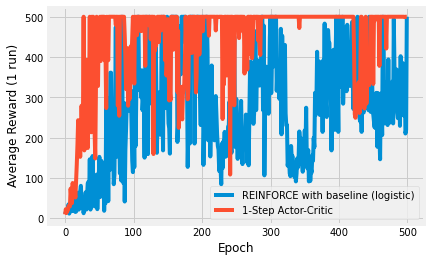

In [ ]:
%matplotlib inline
import matplotlib
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd

def plot(experiment_name, data_files, cutoff=None):
    fig, ax = plt.subplots(nrows=1, ncols=1)
    for j, (name, data_file) in enumerate(data_files):
        df = pd.read_csv(data_file, header=None).transpose()
        if cutoff:
            df = df.truncate(after=cutoff)
        x = df.index.values
        y = df.values
        if len(y.shape) > 1:
            y = y.mean(axis=1)
        ax.yaxis.major.formatter._useMathText = True
        ax.plot(x,
                y,
                label=name)

    ax.set_xlabel('Epoch')
    ax.set_ylabel('Average Reward (1 run)')
    ax.legend(loc='lower right')
    plt.show()

data_files = [
    ("REINFORCE with baseline (logistic)", "results/gym-CartPole-v1/logistic_policy_gradient_with_baseline.csv"),
    ("1-Step Actor-Critic", "results/gym-CartPole-v1/fast_weight_one_step_actor_critic.csv"),
]
plot("reinforce_reward_plot", data_files, cutoff=500)

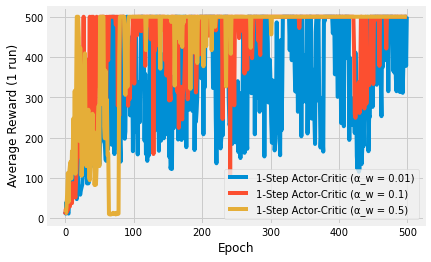

In [ ]:
data_files = [
    ("1-Step Actor-Critic (α_w = 0.01)", "results/gym-CartPole-v1/slow_weight_one_step_actor_critic.csv"),
    ("1-Step Actor-Critic (α_w = 0.1)", "results/gym-CartPole-v1/fast_weight_one_step_actor_critic.csv"),
    ("1-Step Actor-Critic (α_w = 0.5)", "results/gym-CartPole-v1/super_fast_weight_one_step_actor_critic.csv"),
]
plot("reinforce_reward_plot", data_files, cutoff=500)

### Discussion

Algorithms that can bootstrap, or in other words, algorithms that can learn from the get-go, learn faster than those that have to wait until an episode is over. n-step algorithms do this and the first plots demonstrates the increase in performance. The plot is a little noisy due to no averaging.

The second image shows the difference between different learning rate parameters. The fastest (0.5) is very unstable. Sometimes it learns, other times it doesn't, because the policy is changing on each step. The slow (0.01) has a similar performance to the Monte Carlo methods. The learning rate in the middle (0.1) learns fast and is about as stable as the other algorithms. This demonstrates how you must tune your hyperparameters to your specific problem.



# Simple Industrial Example: Automatically Adding Products To A User's Shopping Cart

Covid has sparked demand for online shopping, no more so than online groceries. Yet when I order my groceries, it takes an inordinate amount time to add all of my items to my basket, even with all the "lists" and "favourties" that companies are offering.

What about, instead of placing that burden on the customer, accept that burden and design a system to learn what a customer wants and to order the items with zero user interaction. In an ideal scenario the customers will be suprised but happy to receive an unnanounced order, right as they are running out of crucial groceries.

RL is a potential solution to this problem. By allowing an agent to actively send products and learning from refusals, an agent might be able to pick the right items at the right time.

Obviously in the real world you should constrain the problem and the potential actions to ensure they are safe and robust, but I won't detail that here.

For this experiment I will be using a custom environment based upon some real life data from InstaCart. Find out more about that data in the [gym-shopping-cart](https://gitlab.com/winderresearch/rl/gym-shopping-cart) repository.

## Setup and Previous Agents

This experiment uses the eligibility traces implementation of the actor-critic algorithm. I'm unsure whether this is better than a simpler 1-step actor-critic implementation -- you can test this yourself. I've left the debugging code in to allow you to peak inside, if you're interested.

Below that I've also included an "order everything" and random agents as baselines.

In [ ]:
from simple_rl.agents import *

class EligibilityActorCritic(PolicyGradientAgent):
    def __init__(self, actions, α_θ=0.1, α_w=0.01, prefix="", λ_w=0.1, λ_θ=0.1):
        self.α_θ = α_θ
        self.α_w = α_w
        self.λ_w = λ_w
        self.λ_θ = λ_θ
        self.γ = 0.99
        self.actions = actions
        PolicyGradientAgent.__init__(
            self, name=prefix + "eligibility_actor_critic", actions=actions
        )
        self.reset()

    @staticmethod
    def v(w, S):
        return np.dot(w.T, S)

    @staticmethod
    def Δv(w, S):
        return S

    @staticmethod
    def logistic(x):
        return 1 / (1 + np.exp(-x))

    @staticmethod
    def π(θ, s):
        return EligibilityActorCritic.logistic(np.dot(θ.T, s))

    @staticmethod
    def Δ(θ, s):
        return s - s * EligibilityActorCritic.logistic(np.dot(θ.T, s))

    @staticmethod
    def π_vec(θ, s):
        return np.array(
            [
                EligibilityActorCritic.logistic(np.dot(θ[:, i].T, s))
                for i in range(θ.shape[1])
            ]
        )

    @staticmethod
    def π_mat(θ, s):
        return EligibilityActorCritic.logistic(np.dot(θ.T, s))

    @staticmethod
    def Δ_vec(θ, s):
        return np.array(
            [
                s - s * EligibilityActorCritic.logistic(np.dot(θ[:, i].T, s))
                for i in range(θ.shape[1])
            ]
        )

    @staticmethod
    def Δ_mat(θ, s):
        return s[:, np.newaxis] - np.outer(
            s, EligibilityActorCritic.logistic(np.dot(θ.T, s))
        )

    def update(self, state, action, reward, next_state, terminal: bool):
        v = self.v(self.w, state)
        if terminal:
            δ = reward + self.γ * 0 - v
        else:
            δ = reward + self.γ * self.v(self.w, next_state) - v
        self.delta_buffer.append(δ)
        self.z_w = self.γ * self.λ_w * self.z_w + self.Δv(self.w, state)
        self.w += self.α_w * δ * self.z_w
        self.z_θ[:, action > 0] = (
            self.γ * self.λ_θ * self.z_θ[:, action > 0]
            + self.I * EligibilityActorCritic.Δ_mat(self.θ, state)[:, action > 0]
        )
        self.z_θ[:, action == 0] = self.γ * self.λ_θ * self.z_θ[:, action == 0]
        self.θ += self.α_θ * δ * self.z_θ
        self.I *= self.γ

    def act(self, state, reward):
        if self.θ is None:
            self.θ = np.zeros((len(state.data), len(self.actions)))
        if self.z_θ is None:
            self.z_θ = np.zeros((len(state.data), len(self.actions)))
        if self.w is None:
            self.w = np.zeros(len(state.data))
        if self.z_w is None:
            self.z_w = np.zeros(len(state.data))
        self.data_buffer.append(state.data)
        # print(state.data.shape, state.data[0])
        # state.data = np.ones(state.data.shape)
        # reward = 1
        if self.previous_pair is not None:
            self.update(
                self.previous_pair.state,
                self.previous_pair.action,
                reward,
                state.data,
                state.is_terminal(),
            )
        π = EligibilityActorCritic.π_mat(self.θ, state)
        # print(π[0])
        action = np.array([np.random.choice(a=(0, 1), p=(1 - p, p)) for p in π])
        self.previous_pair = Pair(state.data, action)
        self.t += 1
        return action

    def reset(self):
        self.θ = None
        self.w = None
        self.delta_buffer = []
        self.data_buffer = []
        self.end_of_episode()
        PolicyGradientAgent.reset(self)

    def end_of_episode(self):
        # print(
        #     np.array2string(
        #         self.θ[:, 0], formatter={"float_kind": lambda x: "%.2f" % x}
        #     )
        # )
        # print(
        #     "{:2d}\t{:+.2f}\t{:+.2f}\t{:+.2f}\t{:+.2f}\t{:+.2f}".format(
        #         self.episode_number,
        #         np.mean(self.θ),
        #         np.sum(np.abs(self.θ)),
        #         np.std(self.θ),
        #         np.min(self.θ),
        #         np.max(self.θ),
        #     )
        # )
        # print(np.mean(self.delta_buffer))
        # print(np.array(self.data_buffer).mean(axis=0).shape)
        # print(np.array(self.data_buffer).mean(axis=0))
        self.data_buffer = []
        self.delta_buffer = []
        self.data_buffer = []
        self.z_θ = None
        self.z_w = None
        self.I = 1
        self.t = 0
        self.previous_pair = None
        PolicyGradientAgent.end_of_episode(self)


class AllOnesAgent(Agent):
    """ Custom random agent for multi-binary actions. """

    def __init__(self, actions, prefix=""):
        Agent.__init__(self, name=prefix + "All ones", actions=actions)

    def act(self, state, reward):
        return np.ones((len(self.actions),))


class MultiBinaryRandomAgent(Agent):
    """ Custom random agent for multi-binary actions. """

    def __init__(self, actions, prefix=""):
        Agent.__init__(self, name=prefix + "Random", actions=actions)

    def act(self, state, reward):
        return np.random.choice([1, 0], size=len(self.actions), p=[0.5, 0.5])

## Helper Functions

Next I need a few helper functions, relating to the chosen policy. I'm using a softmax and a hand-derived gradient calculation. You could swap this out for a symbolic or auto-diff approach. Note that I'm using scipy's `check_grad` method to test that the gradient is correct when doing a finite difference calculation.

In [ ]:
from typing import Callable
from collections import namedtuple

import numpy as np
from scipy.optimize import check_grad

def softmax(v):
    exps = np.exp(v)
    sum = np.sum(exps)
    return exps / sum


def softmax_grad(softmax):
    s = softmax.reshape(-1, 1)
    return np.diagflat(s) - np.dot(s, s.T)


def test_differential():
    # Tests that the gradients have been calculated correctly
    s = np.ones((4,))
    θ_test = -1 * np.ones((4, 2))
    test_values = [-1 * np.ones((4, 2)), 0 * np.ones((4, 2)), 1 * np.ones((4, 2))]
    for θ_test in test_values:
        for a in range(θ_test.shape[1]):
            val = check_grad(
                lambda θ: np.log(EligibilityActorCritic.π(θ, s)),
                lambda θ: EligibilityActorCritic.Δ(θ, s),
                θ_test[:, a],
            )
            assert val < 0.0001
    print(
        np.log(EligibilityActorCritic.π(θ_test[:, 0], s)),
        np.log(EligibilityActorCritic.π(θ_test[:, 1], s)),
    )
    print(np.log(EligibilityActorCritic.π_vec(θ_test, s)))
    print(np.log(EligibilityActorCritic.π_mat(θ_test, s)))
    print(
        EligibilityActorCritic.Δ(θ_test[:, 0], s),
        EligibilityActorCritic.Δ(θ_test[:, 1], s),
    )
    print(EligibilityActorCritic.Δ_vec(θ_test, s))
    print(EligibilityActorCritic.Δ_mat(θ_test, s))

Step = namedtuple("Step", ["pair", "reward"])
Pair = namedtuple("Pair", ["state", "action"])

test_differential()

-0.01814992791780973 -0.01814992791780973
[-0.01814993 -0.01814993]
[-0.01814993 -0.01814993]
[0.01798621 0.01798621 0.01798621 0.01798621] [0.01798621 0.01798621 0.01798621 0.01798621]
[[0.01798621 0.01798621 0.01798621 0.01798621]
 [0.01798621 0.01798621 0.01798621 0.01798621]]
[[0.01798621 0.01798621]
 [0.01798621 0.01798621]
 [0.01798621 0.01798621]
 [0.01798621 0.01798621]]


## Running The Experiment: A Single Customer

Now the differential test checks out, we can run the experiment. I'm using the eligibility AC algorithm on a single user. The single customer test data comes straight from the library. This path might change if you use the code somewhere else.

In [ ]:
from pathlib import Path

from simple_rl.tasks import *
from simple_rl.run_experiments import *
from simple_rl.tasks.gym.GymStateClass import GymState
import gym_shopping_cart
from gym_shopping_cart.data.parser import InstacartData

n_instances = 1
n_episodes = 50
max_products = 15

In [ ]:
# Single test user
gym_mdp = GymMDP(env_name="SimpleShoppingCart-v0", render=False)
gym_mdp.env.data = InstacartData(
    gz_file=Path(
        "/opt/conda/lib/python3.7/site-packages/gym_shopping_cart/data/test_data.tar.gz"
    ),
    max_products=max_products,
)
gym_mdp.init_state = GymState(gym_mdp.env.reset())
actions = range(gym_mdp.env.action_space.n)

agent = EligibilityActorCritic(actions, prefix="simple_shopping_single_")
random = MultiBinaryRandomAgent(actions, prefix="simple_shopping_single_")
run_agents_on_mdp(
    [agent, random],
    gym_mdp,
    instances=n_instances,
    episodes=n_episodes,
    steps=1000,
    open_plot=False,
    verbose=False,
    cumulative_plot=False,
)

Overwriting /opt/conda/lib/python3.7/site-packages/gym_shopping_cart/envs/../data/instacart_2017_05_01
Overwriting /opt/conda/lib/python3.7/site-packages/gym_shopping_cart/data/instacart_2017_05_01
Running experiment: 
(MDP)
	gym-SimpleShoppingCart-v0
(Agents)
	simple_shopping_single_eligibility_actor_critic,0
	simple_shopping_single_Random,1
(Params)
	instances : 1
	episodes : 50
	steps : 1000
	track_disc_reward : False

simple_shopping_single_eligibility_actor_critic is learning.
  Instance 1 of 1.

simple_shopping_single_Random is learning.
  Instance 1 of 1.


--- TIMES ---
simple_shopping_single_eligibility_actor_critic agent took 24.59 seconds.
simple_shopping_single_Random agent took 20.32 seconds.
-------------

	simple_shopping_single_eligibility_actor_critic: 40.0 (conf_interv: 0.0 )
	simple_shopping_single_Random: -169.0 (conf_interv: 0.0 )


## Plotting Helper

In [ ]:
%matplotlib inline
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd

def plot(experiment_name, data_files, cutoff=None, y_lim=None, colors=None, y_label="Average Reward (50 runs)"):
    fig, ax = plt.subplots(nrows=1, ncols=1)
    for j, (name, data_file) in enumerate(data_files):
        df = pd.read_csv(data_file, header=None).transpose()
        if cutoff:
            df = df.truncate(after=cutoff)
        x = df.index.values
        y = df.values
        if len(y.shape) > 1:
            y = y.mean(axis=1)
        ax.plot(
            x,
            y,
            label=name,
        )

    ax.set_xlabel("Episode")
    ax.set_ylabel(y_label)
    if y_lim is not None:
        ax.set_ylim(y_lim)
    ax.legend(frameon=False, loc="center right", ncol=1, handlelength=2)
    plt.show()

## Single Customer Results

Take a look at the results below. After 30 or so interactions with the customer, the agent has learnt what they order and what they like. The number of products being returned is now low enough so that the customer keeps more than they return.

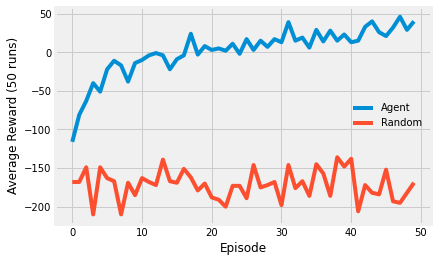

In [ ]:
ac_csv = "results/gym-SimpleShoppingCart-v0/simple_shopping_single_eligibility_actor_critic.csv"
random_csv = "results/gym-SimpleShoppingCart-v0/simple_shopping_single_Random.csv"
data_files = [("Agent", ac_csv), ("Random", random_csv)]
plot("simple_shopping_single_user", data_files, cutoff=100)

## Random Customer Results

This is grand, but this was only a single customer. You'd overfit if you continuously retrained and developed against a single customer. Instead, let's try on random customers. For this you need to download more data.

### Update On the Data

It looks like instacart have removed the data: https://www.instacart.com/datasets/grocery-shopping-2017 no longer exists and the s3 bucket is returning a 403: https://s3.amazonaws.com/instacart-datasets/instacart_online_grocery_shopping_2017_05_01.tar.gz

So thank goodness that I had a local copy of the data on my laptop! Phew. I've uploaded that to a new location. The whole data is about 200MB zipped up. There's more information about this data on kaggle: https://www.kaggle.com/c/instacart-market-basket-analysis/

In [ ]:
!wget -N https://s3.eu-west-2.amazonaws.com/assets.winderresearch.com/data/instacart_online_grocery_shopping_2017_05_01.tar.gz

--2020-10-18 16:16:18--  https://s3.eu-west-2.amazonaws.com/assets.winderresearch.com/data/instacart_online_grocery_shopping_2017_05_01.tar.gz
Resolving s3.eu-west-2.amazonaws.com (s3.eu-west-2.amazonaws.com)... 52.95.149.48
Connecting to s3.eu-west-2.amazonaws.com (s3.eu-west-2.amazonaws.com)|52.95.149.48|:443... connected.
HTTP request sent, awaiting response... 304 Not Modified
File ‘instacart_online_grocery_shopping_2017_05_01.tar.gz’ not modified on server. Omitting download.



In [ ]:
# Random users
gym_mdp = GymMDP(env_name="SimpleShoppingCart-v0", render=False)
gym_mdp.env.data = InstacartData(
    gz_file=Path(
        "instacart_online_grocery_shopping_2017_05_01.tar.gz"
    ),
    max_products=max_products,
)
gym_mdp.init_state = GymState(gym_mdp.env.reset())
actions = range(gym_mdp.env.action_space.n)

agent = EligibilityActorCritic(actions, prefix="simple_shopping_random_")
random = MultiBinaryRandomAgent(actions, prefix="simple_shopping_random_")
run_agents_on_mdp(
    [agent, random],
    gym_mdp,
    instances=n_instances,
    episodes=n_episodes,
    steps=1000,
    open_plot=False,
    verbose=False,
    cumulative_plot=False,
)

Overwriting /opt/conda/lib/python3.7/site-packages/gym_shopping_cart/envs/../data/instacart_2017_05_01
Overwriting instacart_2017_05_01
Running experiment: 
(MDP)
	gym-SimpleShoppingCart-v0
(Agents)
	simple_shopping_random_eligibility_actor_critic,0
	simple_shopping_random_Random,1
(Params)
	instances : 1
	episodes : 50
	steps : 1000
	track_disc_reward : False

simple_shopping_random_eligibility_actor_critic is learning.
  Instance 1 of 1.

simple_shopping_random_Random is learning.
  Instance 1 of 1.


--- TIMES ---
simple_shopping_random_eligibility_actor_critic agent took 32.43 seconds.
simple_shopping_random_Random agent took 28.2 seconds.
-------------

	simple_shopping_random_eligibility_actor_critic: -10.0 (conf_interv: 0.0 )
	simple_shopping_random_Random: -478.0 (conf_interv: 0.0 )


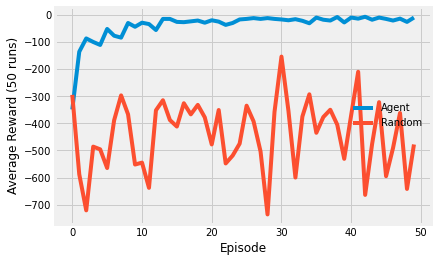

In [ ]:
    ac_csv = "results/gym-SimpleShoppingCart-v0/simple_shopping_random_eligibility_actor_critic.csv"
    random_csv = "results/gym-SimpleShoppingCart-v0/simple_shopping_random_Random.csv"
    data_files = [("Agent", ac_csv), ("Random", random_csv)]
    plot("simple_shopping_random_users", data_files, cutoff=100)

You can see that the random results are much more inconsistent now, because each iteration a random user is getting random products.

Whereas the model is still consistently learning. The performance isn't quite as good any more. Around zero, on average. So this means that people are sending back as many products as they are keeping. I still find this quite remarkable. I've had to do very little so far, and already I'm providing some level of automated service.

## More Products Captain!

In the previous experiment I limited the number of products to only those that were popular. The more products you include, the longer it will take to learn which products people like. Let's try altering the number of products with the current algorithm.

In [ ]:
# Some kind of memory or file leak in here. Not sure what's going on.
# Score vs. num of products
for max_products in [5, 15, 25, 50, 100]:
    gym_mdp = GymMDP(env_name="SimpleShoppingCart-v0", render=False)
    gym_mdp.env.data = InstacartData(
        gz_file=Path(
            "/opt/conda/lib/python3.7/site-packages/gym_shopping_cart/data/test_data.tar.gz"
        ),
        max_products=max_products,
    )
    gym_mdp.init_state = GymState(gym_mdp.env.reset())
    actions = range(gym_mdp.env.action_space.n)

    agent = EligibilityActorCritic(actions, prefix="simple_shopping_random_products_{}_".format(max_products))
    run_agents_on_mdp(
        [agent],
        gym_mdp,
        instances=n_instances,
        episodes=n_episodes,
        steps=1000,
        open_plot=False,
        verbose=False,
        cumulative_plot=False,
    )

Overwriting /opt/conda/lib/python3.7/site-packages/gym_shopping_cart/envs/../data/instacart_2017_05_01
Overwriting /opt/conda/lib/python3.7/site-packages/gym_shopping_cart/data/instacart_2017_05_01
Running experiment: 
(MDP)
	gym-SimpleShoppingCart-v0
(Agents)
	simple_shopping_random_products_5_eligibility_actor_critic,0
(Params)
	instances : 1
	episodes : 50
	steps : 1000
	track_disc_reward : False

simple_shopping_random_products_5_eligibility_actor_critic is learning.
  Instance 1 of 1.


--- TIMES ---
simple_shopping_random_products_5_eligibility_actor_critic agent took 21.9 seconds.
-------------

	simple_shopping_random_products_5_eligibility_actor_critic: 27.0 (conf_interv: 0.0 )
Overwriting /opt/conda/lib/python3.7/site-packages/gym_shopping_cart/envs/../data/instacart_2017_05_01
Overwriting /opt/conda/lib/python3.7/site-packages/gym_shopping_cart/data/instacart_2017_05_01
Running experiment: 
(MDP)
	gym-SimpleShoppingCart-v0
(Agents)
	simple_shopping_random_products_15_eligibi

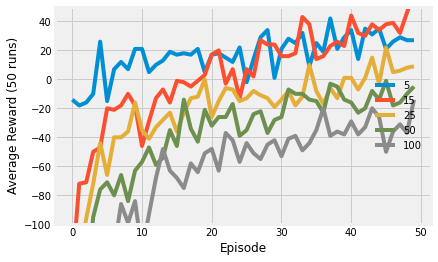

In [ ]:
data_files = []
for max_products in [5, 15, 25, 50, 100]:
    csv = "results/gym-SimpleShoppingCart-v0/simple_shopping_random_products_{}_eligibility_actor_critic.csv".format(max_products)
    data_files.append(("{}".format(max_products), csv))
plot("simple_shopping_num_products", data_files, cutoff=50, y_lim=[-100,50], colors=["#000000", "#222222", "#444444", "#666666", "#888888", "#AAAAAA", "#CCCCCC", "#EEEEEE"])

You can see that as the number of products increase, it becomes harder for the algorithm to choose the right products. It's likely that they would reach optimality at some point, but it takes too many interactions. I've run this on the test data to speed it up, but its the same with the random data.

## Transfer Learning

Instead, what we need to do is learn from all customers and apply those learnings to a new one. There's a range of ways we can do this, but one simple solution is to copy weights and retrain. This isn't perfect, because the raw weights are biased towards previous customers. But they're probably close enough; a good starting point.

In reality you'd have to be a bit more careful about how you'd transfer the wieghts. See the section on scaling in the book for more advanced architectures.

In order to make this work, I need a special "run agents..." method that doesn't reset the environment.

In [ ]:
def no_reset_run_agents_on_mdp(agents,
                        mdp,
                        instances=5,
                        episodes=100,
                        steps=200,
                        clear_old_results=True,
                        rew_step_count=1,
                        track_disc_reward=False,
                        open_plot=True,
                        verbose=False,
                        reset_at_terminal=False,
                        cumulative_plot=True,
                        dir_for_plot="results",
                        experiment_name_prefix="",
                        track_success=False,
                        success_reward=None):
    '''
        This is the same as the simple RL version, but I do not reset the agents.
    '''
    if track_success and success_reward is None:
        raise ValueError("(simple_rl): run_agents_on_mdp must set param @success_reward when @track_success=True.")

    # Experiment (for reproducibility, plotting).
    exp_params = {"instances":instances, "episodes":episodes, "steps":steps}
    experiment = Experiment(agents=agents,
                            mdp=mdp,
                            params=exp_params,
                            is_episodic= episodes > 1,
                            clear_old_results=clear_old_results,
                            track_disc_reward=track_disc_reward,
                            count_r_per_n_timestep=rew_step_count,
                            cumulative_plot=cumulative_plot,
                            dir_for_plot=dir_for_plot,
                            experiment_name_prefix=experiment_name_prefix,
                            track_success=track_success,
                            success_reward=success_reward)

    # Record how long each agent spends learning.
    print("Running experiment: \n" + str(experiment))

    # Learn.
    for agent in agents:
        print(str(agent) + " is learning.")

        # For each instance.
        for instance in range(1, instances + 1):
            print("  Instance " + str(instance) + " of " + str(instances) + ".")
            sys.stdout.flush()
            run_single_agent_on_mdp(agent, mdp, episodes, steps, experiment, verbose, track_disc_reward, reset_at_terminal=reset_at_terminal)
            if "fixed" in agent.name:
                break
            # Reset the agent.
            # agent.reset()
            mdp.end_of_instance()

        print()
    experiment.make_plots(open_plot=open_plot)

In [ ]:
# Train on Random, test on user
n_instances = 1
n_episodes = 50
gym_mdp = GymMDP(env_name="SimpleShoppingCart-v0", render=False)
gym_mdp.env.data = InstacartData(
    gz_file=Path(
        "instacart_online_grocery_shopping_2017_05_01.tar.gz"
    ),
    max_products=max_products,
)
gym_mdp.init_state = GymState(gym_mdp.env.reset())
actions = range(gym_mdp.env.action_space.n)

agent_transfer = EligibilityActorCritic(actions, prefix="simple_shopping_transfer_random_")
no_reset_run_agents_on_mdp(
    [agent_transfer],
    gym_mdp,
    instances=n_instances,
    episodes=n_episodes,
    steps=1000,
    open_plot=False,
    verbose=False,
    cumulative_plot=False,
    reset_at_terminal=False,
)

n_episodes = 200
gym_mdp.env.data = InstacartData(
    gz_file=Path(
        "instacart_online_grocery_shopping_2017_05_01.tar.gz"
    ),
    max_products=max_products,
)
gym_mdp.init_state = GymState(gym_mdp.env.reset())
actions = range(gym_mdp.env.action_space.n)

agent = EligibilityActorCritic(actions, prefix="simple_shopping_transfer_single_")
agent.θ = agent_transfer.θ
agent.w = agent_transfer.w
no_reset_run_agents_on_mdp(
    [agent],
    gym_mdp,
    instances=n_instances,
    episodes=n_episodes,
    steps=1000,
    open_plot=False,
    verbose=False,
    cumulative_plot=False,
    reset_at_terminal=False,
)

Overwriting /opt/conda/lib/python3.7/site-packages/gym_shopping_cart/envs/../data/instacart_2017_05_01
Overwriting instacart_2017_05_01
Running experiment: 
(MDP)
	gym-SimpleShoppingCart-v0
(Agents)
	simple_shopping_transfer_random_eligibility_actor_critic,0
(Params)
	instances : 1
	episodes : 50
	steps : 1000
	track_disc_reward : False

simple_shopping_transfer_random_eligibility_actor_critic is learning.
  Instance 1 of 1.

	simple_shopping_transfer_random_eligibility_actor_critic: -31.0 (conf_interv: 0.0 )
Overwriting instacart_2017_05_01
Running experiment: 
(MDP)
	gym-SimpleShoppingCart-v0
(Agents)
	simple_shopping_transfer_single_eligibility_actor_critic,0
(Params)
	instances : 1
	episodes : 200
	steps : 1000
	track_disc_reward : False

simple_shopping_transfer_single_eligibility_actor_critic is learning.
  Instance 1 of 1.

	simple_shopping_transfer_single_eligibility_actor_critic: -4.0 (conf_interv: 0.0 )


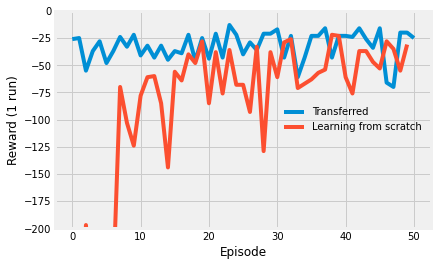

In [ ]:
# Transfer learning
random_csv = "results/gym-SimpleShoppingCart-v0/simple_shopping_transfer_random_eligibility_actor_critic.csv"
single_csv = "results/gym-SimpleShoppingCart-v0/simple_shopping_transfer_single_eligibility_actor_critic.csv"
data_files = [("Transferred", single_csv),("Learning from scratch", random_csv),]
plot("simple_shopping_transfer_learning", data_files, cutoff=50, y_lim=[-200, 0], colors=["#000000", "#888888",], y_label="Reward (1 run)")

Now look at those results! The agent is learning which products the customer likes in next to no time at all. The reason for this is that the baseline policy created by the parameters learnt from other customers also works well for new customers. It only takes a few episodes, on average, to converge to an optimal policy.

Yes, there are still caveats. These results are limited to the most popular products, for example. Most people buy milk, so simply re-ordering milk is a quick win. But still, pretty amazing! 

## Future Work

There's a wide range of ideas that you could apply after this. For example, rather than using the raw data, it would be better to build a world model and use that to explore in; that would be more representative of the real world. You could try predicting the numbers of products, as well as the type. You could add more products. You could attempt to encode safety rules to prevent stupid suggestions.


# Homework

Reinforcement Learning is a little more involved than the previous examples we saw, and it might take a while for us to find a setting where it works well for us. In this homework, we will be focusing on thinking of reinforcement learning scenarios as much as we will implement code.

**1)** How would you use reinforcement learning to solve social scientific questions? Be clear in your answer about the environment, the possible states, the actions and its states, reward functions, and trajectories.

In [ ]:
rl_world = 'value' #@param {type:"string"}

**2)** Simulate or find data which best matches your social science question and related scenarios. 

**3)** **STRETCH** Use a reinforcement learning algorithm to attempt to model your agents in its environment, and discuss what social scientific insights you can gather.

**4)** Use a reinforcement learning algorithm on any dataset which is not used in this notebook. 